
# -------------------------------------------------------------------------------------------------------
#             AIML Online Capstone - AUTOMATIC TICKET ASSIGNMENT
# -------------------------------------------------------------------------------------------------------

# STATEMENT OF THE PROBLEM
An incident is something that is unplanned interruption to an IT service or
reduction in the quality of an IT service that affects the Users and the Business. The main goal of Incident Management process is to provide a quick fix / workarounds or solutions thatresolves the interruption and restores the service to its full capacity to ensure no business
impact.

In most of the organizations, incidents are created by various Business and IT Users, End Users/ Vendors if they have access to ticketing systems, and from the integrated monitoring systems and tools. Assigning the incidents to the appropriate person or unit in the support team has critical importance to provide improved user satisfaction while ensuring better allocation of support resources. The assignment of incidents to appropriate IT groups is still a manual process in many of the IT organizations.

Manual assignment of incidents is time consuming and requires human efforts. There may be mistakes due to human errors and resource consumption is carried out ineffectively because of the misaddressing. On the other hand, manual assignment increases the response and resolution times which result in user satisfaction deterioration / poor customer service.

#OBJECTIVES

In this capstone project, the goal is to build a classifier that can classify the tickets by analysing text. Details about the data and dataset files are given in below link, https://drive.google.com/file/d/1OZNJm81JXucV3HmZroMq6qCT2m7ez7IJ
    

Milestone 1: Pre-Processing, Data Visualisation and EDA Overview

● Exploring the given Data files

● Understanding the structure of data

● Missing points in data

● Finding inconsistencies in the data

● Visualizing different patterns

● Visualizing different text features

● Dealing with missing values

● Text preprocessing

● Creating word vocabulary from the corpus of report text data

● Creating tokens as required

# Milestone 1: Pre-Processing, Data Visualisation And EDA Overview

### Importing Necessary Packages
    Here we are importing various packages, which will be used in this project.

In [1]:

#For Numerial Operations numpy(Numerical Python)
import numpy as np
#For Data Analysis pandas(Python Data Analysis Library)
import pandas as pd
#To use regular Expression Operations
import re

#To enable matplotlib to plot in Jupyter Notebook
%matplotlib inline

#For object-oriented plotting
from pylab import *
from sklearn.feature_extraction.text import CountVectorizer

#For String Functions based on Regular Expressions
import string
#To Remove Stopwords
from nltk.corpus import stopwords
#To Split Strings into Substrings
from nltk.tokenize import RegexpTokenizer
#Lemmatization using WordNet
from nltk.stem import WordNetLemmatizer
#Stemming of Words using PorterStemmer
from nltk.stem.porter import PorterStemmer

#To Split Train/Test Data Models
from sklearn.model_selection import train_test_split
#To Ecode Categorical Features into Neumerical Values
from sklearn.preprocessing import LabelEncoder

### Importing Dataset
    Note: Please provide the valid file_path, We will be importing the Excel file "Input Data Synthetic (created but not used in our project)".

In [2]:
file_path = r'/Users/thani/Documents/DW/PGP_AI_ML/Final_Project/'
file_name = r'Input Data Synthetic (created but not used in our project).xlsx'

In [3]:
dataset = pd.read_excel (file_path+file_name)


# Understanding The Structure Of Dataset

---



---



The below output gives the quick idea about the structure of the imported Dataset.

In [4]:
#To view Top 5 Rows of the Dataset 
dataset.head()

,Short description,Description,Caller,Assignment group
0,login issue,-verified user details.(employee# & manager na...,spxjnwir pjlcoqds,GRP_0
1,outlook,\r\n\r\nreceived from: hmjdrvpb.komuaywn@gmail...,hmjdrvpb komuaywn,GRP_0
2,cant log in to vpn,\r\n\r\nreceived from: eylqgodm.ybqkwiam@gmail...,eylqgodm ybqkwiam,GRP_0
3,unable to access hr_tool page,unable to access hr_tool page,xbkucsvz gcpydteq,GRP_0
4,skype error,skype error,owlgqjme qhcozdfx,GRP_0


In [5]:
##To view Bottom 5 Rows of the Dataset 
dataset.tail()

,Short description,Description,Caller,Assignment group
8495,emails not coming in from zz mail,\r\n\r\nreceived from: avglmrts.vhqmtiua@gmail...,avglmrts vhqmtiua,GRP_29
8496,telephony_software issue,telephony_software issue,rbozivdq gmlhrtvp,GRP_0
8497,vip2: windows password reset for tifpdchb pedx...,vip2: windows password reset for tifpdchb pedx...,oybwdsgx oxyhwrfz,GRP_0
8498,machine nÃ£o estÃ¡ funcionando,i am unable to access the machine utilities to...,ufawcgob aowhxjky,GRP_62
8499,an mehreren pc`s lassen sich verschiedene prgr...,an mehreren pc`s lassen sich verschiedene prgr...,kqvbrspl jyzoklfx,GRP_49


In [6]:
#To Find the Shape of the Dataset
dataset.shape

(8500, 4)

The above result explains that the shape of the Dataset, 

where in, it has 8500 rows and 4 columns.

In [7]:
#To Find Statistical Information of the Dataset
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8500 entries, 0 to 8499
Data columns (total 4 columns):
Short description    8492 non-null object
Description          8499 non-null object
Caller               8500 non-null object
Assignment group     8500 non-null object
dtypes: object(4)
memory usage: 265.7+ KB


In [8]:
#To Know Statistical Description of the Dataset
dataset.describe().transpose()

,count,unique,top,freq
Short description,8492,7481,password reset,38
Description,8499,7817,the,56
Caller,8500,2950,bpctwhsn kzqsbmtp,810
Assignment group,8500,74,GRP_0,3976


As per the above Statistics, we can infer the following:

1. Short description
        This column is having 8492 rows out of 8500, might be some data missing. 
        This column has 7481 unique records out of 8500 rows, might be having some duplicates.
        This column is has password reset has a hightest frequency of 38.
2. Description
        This column is having 8499 rows out of 8500, might be some data missing.
        This column is having 7817 unique records out of 8500 rows, might be having some duplicates.
        This column is having word 'the' has a highest frequency of 56
3. Caller
        The column caller has 8500 rows, and this has 2950 unique caller. 
        Also the user "bpctwhsn kzqsbmtp" has reported high volumn of tickets of 810.

4. Assignment group
        This column has 8500 rows and 74 unique group. 
        Also, group GRP_0 is having highest frequency of 3976. This also explains that close to 40% belongs to one group. 
        This column attracts more attention.

# Finding Missing Values In The Dataset

In [9]:
#To Identify Null Values in the Dataset
dataset.isnull().sum()

Short description    8
Description          1
Caller               0
Assignment group     0
dtype: int64

In [10]:
print("Short description column has ", round((8/8500)*100,2), "% missing data")
print("Description column has ", round((1/8500)*100,2), "% missing data")

Short description column has  0.09 % missing data
Description column has  0.01 % missing data


In [11]:
#To Drop Null Values.
dataset = dataset.dropna()

#### As per the above analysis, we found that less than 1 % of the records in "short description" and "description" columns have missing data. 
With this, we have taken decision "*To Drop the 9 rows from give dataset, by beliving that this action will not impact the model.*"

In [12]:
#Cross-Validating the Null or Missing Record
dataset.isnull().sum()

Short description    0
Description          0
Caller               0
Assignment group     0
dtype: int64

In [13]:
#Validating the Shape of the Dataset after Removing Null Values
dataset.shape

(8491, 4)

As per the results from above operations, we can see that the missing data has been removed from dataset.

# Finding Inconsistencies In The Dataset

In [14]:
#To Visualize a Sample of Dataset
print(dataset['Description'][2])



received from: eylqgodm.ybqkwiam@gmail.com

hi

i cannot log on to vpn

best 


In [15]:
#Renaming Column Names of the Dataset as per Convenience
dataset.rename(columns={'Short description' : 'Short_description',
                        'Assignment group' : 'Assignment_group'}, inplace='True')

In [16]:
#Validating the Renamed Columns
dataset.head()

,Short_description,Description,Caller,Assignment_group
0,login issue,-verified user details.(employee# & manager na...,spxjnwir pjlcoqds,GRP_0
1,outlook,\r\n\r\nreceived from: hmjdrvpb.komuaywn@gmail...,hmjdrvpb komuaywn,GRP_0
2,cant log in to vpn,\r\n\r\nreceived from: eylqgodm.ybqkwiam@gmail...,eylqgodm ybqkwiam,GRP_0
3,unable to access hr_tool page,unable to access hr_tool page,xbkucsvz gcpydteq,GRP_0
4,skype error,skype error,owlgqjme qhcozdfx,GRP_0


We can see that, the data inconsisency in the "Description" and  the "Short_escription" columns.

There are also some special characters present in the dataset.

To address this, we shall apply some Data Transformation Process and Clean the Dataset.

In [17]:
#To Remove Anything that is Not a Letter(Special Characters)
dataset.Description = dataset.Description.apply(lambda x: re.sub('[^A-Za-z]+', ' ', x))
dataset.Short_description = dataset.Short_description.apply(lambda x: re.sub('[^A-Za-z]+', ' ', x))

The below step will ensure that the "Description" and "Short_description"  columns will have same case.

In [18]:
dataset.Description = dataset.Description.apply(lambda x: x.lower())
dataset.Short_description = dataset.Short_description.apply(lambda x: x.lower())

In [19]:
dataset.Description = dataset.Description.apply(lambda x: x.strip())
dataset.Short_description = dataset.Short_description.apply(lambda x: x.strip())

In [20]:
#Validating above Actions Performed
dataset.head()

,Short_description,Description,Caller,Assignment_group
0,login issue,verified user details employee manager name ch...,spxjnwir pjlcoqds,GRP_0
1,outlook,received from hmjdrvpb komuaywn gmail com hell...,hmjdrvpb komuaywn,GRP_0
2,cant log in to vpn,received from eylqgodm ybqkwiam gmail com hi i...,eylqgodm ybqkwiam,GRP_0
3,unable to access hr tool page,unable to access hr tool page,xbkucsvz gcpydteq,GRP_0
4,skype error,skype error,owlgqjme qhcozdfx,GRP_0


In [21]:
#To Understanding/Analyzing "Assignment_group" Data Consistency
dataset.groupby(dataset['Assignment_group']).size()

Assignment_group
GRP_0     3968
GRP_1       31
GRP_10     140
GRP_11      30
GRP_12     257
GRP_13     145
GRP_14     118
GRP_15      39
GRP_16      85
GRP_17      81
GRP_18      88
GRP_19     215
GRP_2      241
GRP_20      36
GRP_21      29
GRP_22      31
GRP_23      25
GRP_24     289
GRP_25     116
GRP_26      56
GRP_27      18
GRP_28      44
GRP_29      97
GRP_3      200
GRP_30      39
GRP_31      69
GRP_32       4
GRP_33     107
GRP_34      61
GRP_35       1
          ... 
GRP_49       6
GRP_5      129
GRP_50      14
GRP_51       8
GRP_52       9
GRP_53      11
GRP_54       2
GRP_55       8
GRP_56       3
GRP_57       2
GRP_58       3
GRP_59       6
GRP_6      184
GRP_60      20
GRP_61       1
GRP_62      25
GRP_63       3
GRP_64       1
GRP_65      11
GRP_66       4
GRP_67       1
GRP_68       3
GRP_69       2
GRP_7       68
GRP_70       1
GRP_71       2
GRP_72       2
GRP_73       1
GRP_8      661
GRP_9      252
Length: 74, dtype: int64

In [22]:
#Dropping the "Caller" column, as it is just user information and has no scope for our analysis.
#dataset = dataset.drop('Caller', axis=1)

In [23]:
#To Creating a "newcolumn" Combining "Short_descriotion" and "Description"
dataset['newcolumn'] = dataset['Short_description'] + ' ' + dataset['Description']
dataset.head(6)

,Short_description,Description,Caller,Assignment_group,newcolumn
0,login issue,verified user details employee manager name ch...,spxjnwir pjlcoqds,GRP_0,login issue verified user details employee man...
1,outlook,received from hmjdrvpb komuaywn gmail com hell...,hmjdrvpb komuaywn,GRP_0,outlook received from hmjdrvpb komuaywn gmail ...
2,cant log in to vpn,received from eylqgodm ybqkwiam gmail com hi i...,eylqgodm ybqkwiam,GRP_0,cant log in to vpn received from eylqgodm ybqk...
3,unable to access hr tool page,unable to access hr tool page,xbkucsvz gcpydteq,GRP_0,unable to access hr tool page unable to access...
4,skype error,skype error,owlgqjme qhcozdfx,GRP_0,skype error skype error
5,unable to log in to engineering tool and skype,unable to log in to engineering tool and skype,eflahbxn ltdgrvkz,GRP_0,unable to log in to engineering tool and skype...


In [24]:
#To find the Unique Observations in "newcolumn"
dataset['newcolumn'].nunique()

6761

There are 6761 Unique Tickets are there in Dataset.

In [25]:
#To find all the Rows with Specific String Value
dataset[dataset['newcolumn'].str.contains('account locked account locked')]

,Short_description,Description,Caller,Assignment_group,newcolumn
423,account locked,account locked,bkyphsgq cfyksehu,GRP_0,account locked account locked
1255,account locked,account locked,ewvibrfg atlurzdn,GRP_0,account locked account locked
1449,account locked,account locked,dyqekzuc djhznybt,GRP_0,account locked account locked
1525,account locked,account locked,ndrtahvm kjhdybzm,GRP_0,account locked account locked
1526,account locked,account locked,vgzmjkop rgeubdco,GRP_0,account locked account locked
2134,account locked,account locked,nsoikcyf jhybqael,GRP_0,account locked account locked
2424,account locked,account locked,tigwlquj evynjiar,GRP_0,account locked account locked
2943,account locked,account locked,qmgspxkf mckfysdh,GRP_0,account locked account locked
3075,account locked,account locked,sygionua szunhced,GRP_34,account locked account locked
3396,account locked,account locked,qifzkoej etbmgjvo,GRP_0,account locked account locked


The above result shows the presence and the location of duplicate questions.

# Fixing Duplicate Issue

In [26]:
#To Filter Out Dataset by Column Name
new_df = dataset.filter(['newcolumn','Assignment_group'], axis=1)

In [27]:
#To Drop the Duplicate Values Present
new_df.drop_duplicates(subset ="newcolumn", 
                     keep = False, inplace = True) 

In [28]:
#To Know the Shape after Droping Duplicates
new_df.shape

(6475, 2)

In [29]:
#To Know the Percentage of Droped Data
print(round(100 - (6475/8541*100))," % of data is droped")

24  % of data is droped


In [30]:
#To look-up New DataFrame
new_df.head()

,newcolumn,Assignment_group
0,login issue verified user details employee man...,GRP_0
1,outlook received from hmjdrvpb komuaywn gmail ...,GRP_0
2,cant log in to vpn received from eylqgodm ybqk...,GRP_0
3,unable to access hr tool page unable to access...,GRP_0
5,unable to log in to engineering tool and skype...,GRP_0


In [31]:
#new_df.groupby(new_df['Assignment_group']).size()
g1 = new_df.groupby(['Assignment_group'], as_index=False).count()

In [32]:
#The result shows the sample data
print(new_df['newcolumn'][2])

cant log in to vpn received from eylqgodm ybqkwiam gmail com hi i cannot log on to vpn best


In [33]:
print(dataset['newcolumn'][2])

cant log in to vpn received from eylqgodm ybqkwiam gmail com hi i cannot log on to vpn best


In [34]:
dataset = new_df

The below columns to find the sentence length and word count for the rows

In [35]:
dataset['newcolumn_len'] = dataset['newcolumn'].astype(str).apply(len)
dataset['word_count'] = dataset['newcolumn'].apply(lambda x: len(str(x).split()))

# Visualizing Different Patterns

The below plot shows the sentance count distribution. 

Where, X-axis is Sentence Count and Y-axis is Frequency.

(array([4.610e+02, 1.496e+03, 1.216e+03, 9.220e+02, 6.590e+02, 4.160e+02,
        3.020e+02, 1.950e+02, 1.610e+02, 9.100e+01, 7.600e+01, 5.300e+01,
        3.700e+01, 3.300e+01, 1.240e+02, 5.300e+01, 2.000e+01, 1.100e+01,
        1.200e+01, 1.200e+01, 2.000e+01, 1.200e+01, 1.300e+01, 8.000e+00,
        1.200e+01, 3.000e+00, 5.000e+00, 1.000e+00, 5.000e+00, 5.000e+00,
        0.000e+00, 1.000e+00, 0.000e+00, 0.000e+00, 0.000e+00, 3.000e+00,
        2.000e+00, 2.000e+00, 1.000e+00, 2.000e+00, 4.000e+00, 1.000e+00,
        1.000e+00, 2.000e+00, 0.000e+00, 1.000e+00, 0.000e+00, 0.000e+00,
        1.000e+00, 0.000e+00, 1.000e+00, 0.000e+00, 0.000e+00, 0.000e+00,
        0.000e+00, 1.000e+00, 1.000e+00, 0.000e+00, 1.000e+00, 1.000e+00,
        0.000e+00, 1.000e+00, 0.000e+00, 0.000e+00, 1.000e+00, 1.000e+00,
        1.000e+00, 0.000e+00, 1.000e+00, 0.000e+00, 0.000e+00, 1.000e+00,
        0.000e+00, 2.000e+00, 0.000e+00, 0.000e+00, 1.000e+00, 0.000e+00,
        0.000e+00, 1.000e+00, 0.000e+0

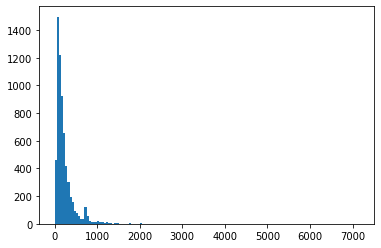

In [36]:
#Histogram for Count Distribution
binwidth = 50
plt.hist(dataset['newcolumn_len'], bins=range(min(dataset['newcolumn_len']), max(dataset['newcolumn_len']) + binwidth, binwidth))

The plot shows the distribution by word count.

Where, X-axis is Word Count and Y-axis is Frequency.

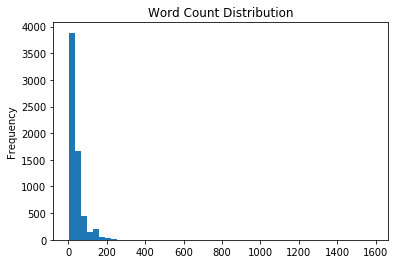

In [37]:
#Histogram for Count Distribution
dataset['word_count'].plot(
    kind='hist',
    bins=50,
    title='Word Count Distribution')

The below chart shows the Target variable distribution.

Where X-axis is Assignment-group and Y-axis is Frequency.

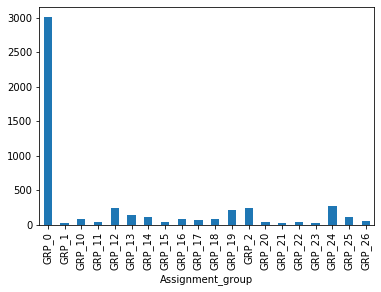

In [38]:
#Histogram for Count Distribution
dataset.groupby('Assignment_group').count()['newcolumn'].head(20).plot(kind='bar')

The above chart describes that the record count of Target Variables.

# Visualizing Different Text Features And Creating Word Vocabulary From The Corpus Of Report Text Data

#The Distribution Of Top Unigrams Before Removing Stop Words

to 7727
the 6511
is 3380
in 3243
com 2857
no 2825
not 2788
on 2640
from 2604
and 2550
for 2494
gmail 2190
please 2147
yes 1989
na 1910
company 1785
password 1778
of 1719
erp 1695
it 1675
tool 1583
received 1485
this 1458
access 1336
user 1311
my 1173
issue 1169
with 1143
unable 1136
reset 1091
sid 1056
you 1043
have 1005
can 959
error 948
am 883
email 874
are 841
at 827
hostname 819
site 812
be 809
outlook 802
working 793
ticket 784
we 777
that 746
when 739
help 729
as 725


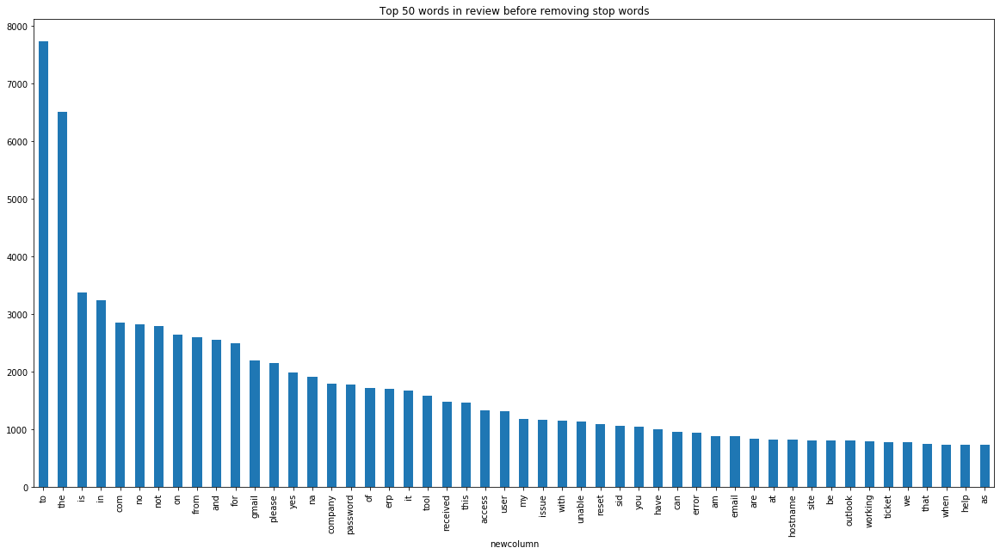

In [39]:
#To know the Distribution of Unigram
def get_top_n_words(corpus, n=None):
    vec = CountVectorizer().fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]

common_words = get_top_n_words(dataset['newcolumn'], 50)

for word, freq in common_words:
    print(word, freq)

dataset1 = pd.DataFrame(common_words, columns = ['newcolumn' , 'count'])

#Histogram for Count Distribution
plt.subplots(figsize=(20,10))

dataset1.groupby('newcolumn').sum()['count'].sort_values(ascending=False).plot(kind='bar', title='Top 50 words in review before removing stop words')


#The Distribution Of Top Bigrams Before Removing Stop Words

gmail com 2190
yes no 1710
no na 1548
received from 1360
unable to 1125
is not 620
to the 609
company com 501
cid image 475
not working 453
able to 441
backup circuit 435
no yes 421
com hello 395
in the 387
engineering tool 383
password reset 378
access to 347
collaboration platform 326
telecom vendor 321
on the 315
et on 313
type of 308
of the 304
to login 287
is down 286
na company 285
na yes 285
not able 282
what type 282
of outage 282
scheduled maintenance 282
you please 277
need to 273
image png 268
com mailto 258
can you 255
erp sid 255
to be 241
please help 236
password for 236
login to 234
the user 233
password management 232
management tool 231
yes yes 227
com hi 221
it is 220
am et 213
to access 212


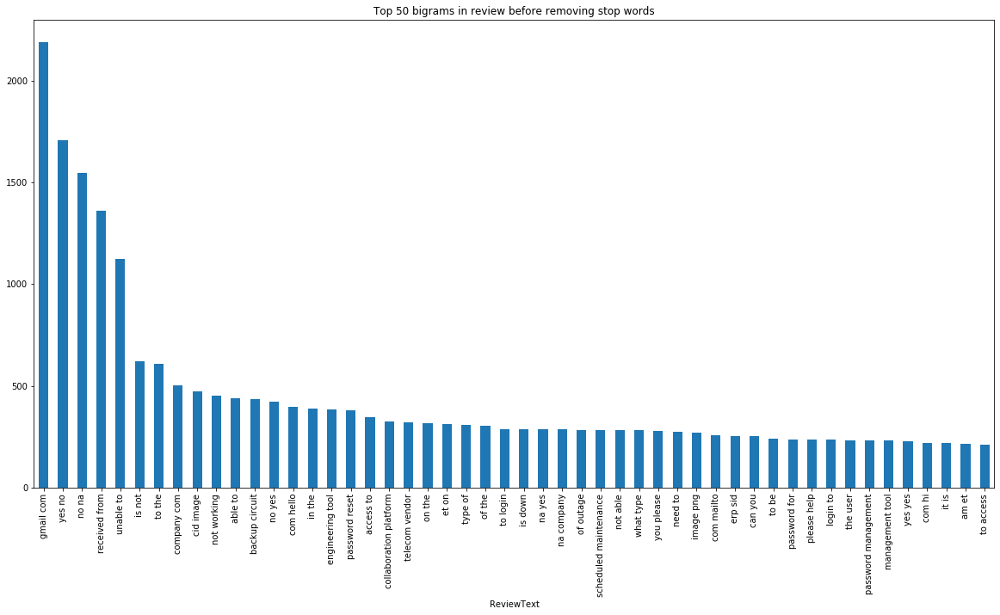

In [40]:
#To know the Distribution of Unigram
def get_top_n_bigram(corpus, n=None):
    vec = CountVectorizer(ngram_range=(2, 2)).fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]


common_words = get_top_n_bigram(dataset['newcolumn'], 50)


for word, freq in common_words:
    print(word, freq)


dataset3 = pd.DataFrame(common_words, columns = ['ReviewText' , 'count'])

#Histogram for Count Distribution
plt.subplots(figsize=(20,10))

dataset3.groupby('ReviewText').sum()['count'].sort_values(ascending=False).plot(kind='bar', title='Top 50 bigrams in review before removing stop words')


# The Distribution Of Top Trigrams Before Removing Stop Words

yes no na 1548
no yes no 419
gmail com hello 373
na yes no 285
what type of 282
type of outage 282
no na company 281
not able to 278
cid image png 267
password management tool 231
yes yes no 227
cid image jpg 208
gmail com mailto 208
gmail com hi 207
to login to 197
am et on 189
backup circuit yes 181
is not working 180
browser microsoft internet 167
microsoft internet explorer 167
internet explorer email 167
com customer number 166
language browser microsoft 164
in job scheduler 162
customer number telephone 159
gmail com customer 158
number telephone summary 157
gmail com dear 156
is down since 154
unable to login 151
telecom vendor telecom 147
vendor telecom vendor 147
management tool password 145
when did it 143
did it start 142
site have backup 142
on backup circuit 142
of outage network 141
power please specify 141
please specify what 141
specify what type 141
of outage top 141
outage top cert 141
top cert site 141
no na when 141
na when did 141
scheduled maintenance power 141
sc

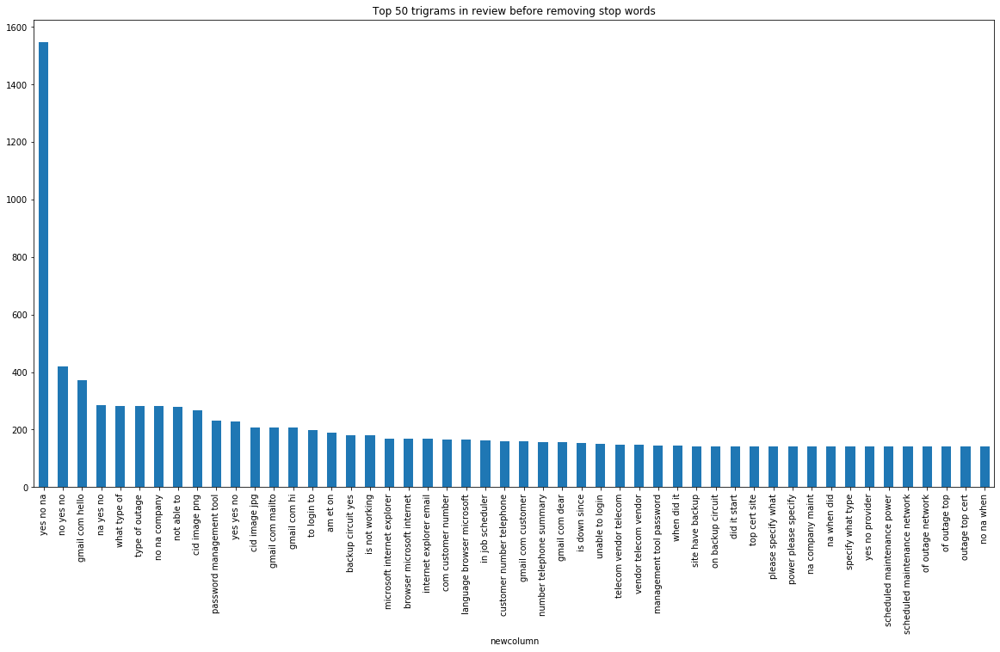

In [41]:
#To know the Distribution of Trigram
def get_top_n_trigram(corpus, n=None):
    vec = CountVectorizer(ngram_range=(3, 3)).fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]

common_words = get_top_n_trigram(dataset['newcolumn'], 50)

for word, freq in common_words:
    print(word, freq)

dataset5 = pd.DataFrame(common_words, columns = ['newcolumn' , 'count'])

#Histogram for Count Distribution
plt.subplots(figsize=(20,10))

dataset5.groupby('newcolumn').sum()['count'].sort_values(ascending=False).plot(kind='bar',title='Top 50 trigrams in review before removing stop words')


# Remove Punctuation:

In [42]:
#Function to Remove Punctuaion 
def remove_punctuation(text):
    no_punct = "".join([c for c in text if c not in string.punctuation])
    return no_punct

In [43]:
#Applying Remove Punctuation Function
dataset['newcolumn'] = dataset['newcolumn'].apply(lambda X: remove_punctuation(X))

In [44]:
#Validating Removal of Punctuation
dataset['newcolumn'].head(10)

0     login issue verified user details employee man...
1     outlook received from hmjdrvpb komuaywn gmail ...
2     cant log in to vpn received from eylqgodm ybqk...
3     unable to access hr tool page unable to access...
5     unable to log in to engineering tool and skype...
6     event critical hostname company com the value ...
7     ticket no employment status new non employee e...
8     unable to disable add ins on outlook unable to...
10    engineering tool says not connected and unable...
11    hr tool site not loading page correctly hr too...
Name: newcolumn, dtype: object

The below sample shows that the result after Removing Punctuations.

In [45]:
#Validating the Punctuation removal of a single field
dataset['newcolumn'].iloc[0]

'login issue verified user details employee manager name checked the user name in ad and reset the password advised the user to login and check caller confirmed that he was able to login issue resolved'

# Creating Tokens As Required

In [46]:
#Regular Expression Tokenizer
tokenizer = RegexpTokenizer(r'\w+')

In [47]:
#Applying Regular Expression Tokenizer on Dataset
dataset['newcolumn'] = dataset['newcolumn'].apply(lambda X: tokenizer.tokenize(X.lower()))

In [48]:
#Validating Tokens Created
dataset['newcolumn'].head(10)

0     [login, issue, verified, user, details, employ...
1     [outlook, received, from, hmjdrvpb, komuaywn, ...
2     [cant, log, in, to, vpn, received, from, eylqg...
3     [unable, to, access, hr, tool, page, unable, t...
5     [unable, to, log, in, to, engineering, tool, a...
6     [event, critical, hostname, company, com, the,...
7     [ticket, no, employment, status, new, non, emp...
8     [unable, to, disable, add, ins, on, outlook, u...
10    [engineering, tool, says, not, connected, and,...
11    [hr, tool, site, not, loading, page, correctly...
Name: newcolumn, dtype: object

The below sample shows the tokenized values

In [49]:
#Validating the Tokens of a single field
dataset['newcolumn'].iloc[1]

['outlook',
 'received',
 'from',
 'hmjdrvpb',
 'komuaywn',
 'gmail',
 'com',
 'hello',
 'team',
 'my',
 'meetings',
 'skype',
 'meetings',
 'etc',
 'are',
 'not',
 'appearing',
 'in',
 'my',
 'outlook',
 'calendar',
 'can',
 'somebody',
 'please',
 'advise',
 'how',
 'to',
 'correct',
 'this',
 'kind']

# Removal of Stop Words:

We imported a list of the most frequently used words from the NL Toolkit at the beginning with from nltk.corpus import stopwords. You can run stopwords.word(insert language) to get a full list for every language. There are 179 English words, including ‘i’, ‘me’, ‘my’, ‘myself’, ‘we’, ‘you’, ‘he’, ‘his’, for example. We usually want to remove these because they have low predictive power. There are occasions when you may want to keep them though. Such as, if your corpus is very small and removing stop words would decrease the total number of words by a large percent.

In [50]:
#Stop Word Removal Function
def remove_stopwords(text):
    words = [w for w in text if w not in stopwords.words('english')]
    return words

In [51]:
#Applying Stop Word Removal Function on Dataset
dataset['newcolumn'] = dataset['newcolumn'].apply(lambda X: remove_stopwords(X))

In [52]:
#Validating Stop Word Removal Function
dataset['newcolumn'].head(10)

0     [login, issue, verified, user, details, employ...
1     [outlook, received, hmjdrvpb, komuaywn, gmail,...
2     [cant, log, vpn, received, eylqgodm, ybqkwiam,...
3     [unable, access, hr, tool, page, unable, acces...
5     [unable, log, engineering, tool, skype, unable...
6     [event, critical, hostname, company, com, valu...
7     [ticket, employment, status, new, non, employe...
8     [unable, disable, add, ins, outlook, unable, d...
10    [engineering, tool, says, connected, unable, s...
11    [hr, tool, site, loading, page, correctly, hr,...
Name: newcolumn, dtype: object

The below sample shows after removing stop words

In [53]:
#Validating Stop Word Removal Function on Single Field
dataset['newcolumn'].iloc[1]

['outlook',
 'received',
 'hmjdrvpb',
 'komuaywn',
 'gmail',
 'com',
 'hello',
 'team',
 'meetings',
 'skype',
 'meetings',
 'etc',
 'appearing',
 'outlook',
 'calendar',
 'somebody',
 'please',
 'advise',
 'correct',
 'kind']

# Stemming And Lemmatizing:

In [54]:
#Importing Necessary Package
import nltk
nltk.download('wordnet')

[nltk_data] Downloading package wordnet to /Users/thani/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

In [55]:
#Lemmatizer
lemmatizer = WordNetLemmatizer()

def word_lemmatizer(text):
    lem_text = [lemmatizer.lemmatize(i) for i in text]
    return lem_text

In [56]:
# Applying Lemmatizer on Dataset
dataset['newcolumn'] = dataset['newcolumn'].apply(lambda X: word_lemmatizer(X))

The below sample shows after applying lemmatizing

In [57]:
#Validating Lemmatizer Function
dataset['newcolumn'].head(10)

0     [login, issue, verified, user, detail, employe...
1     [outlook, received, hmjdrvpb, komuaywn, gmail,...
2     [cant, log, vpn, received, eylqgodm, ybqkwiam,...
3     [unable, access, hr, tool, page, unable, acces...
5     [unable, log, engineering, tool, skype, unable...
6     [event, critical, hostname, company, com, valu...
7     [ticket, employment, status, new, non, employe...
8     [unable, disable, add, in, outlook, unable, di...
10    [engineering, tool, say, connected, unable, su...
11    [hr, tool, site, loading, page, correctly, hr,...
Name: newcolumn, dtype: object

In [58]:
#Validating Lemmatizer Function on a Single Field
dataset['newcolumn'].iloc[0]

['login',
 'issue',
 'verified',
 'user',
 'detail',
 'employee',
 'manager',
 'name',
 'checked',
 'user',
 'name',
 'ad',
 'reset',
 'password',
 'advised',
 'user',
 'login',
 'check',
 'caller',
 'confirmed',
 'able',
 'login',
 'issue',
 'resolved']

In [59]:
#Stemmer
stemmer = PorterStemmer()

def word_stemmer(text):
    stem_text = " ".join([stemmer.stem(i) for i in text])
    return stem_text

In [60]:
#Applying Stemmer on Dataset
dataset['newcolumn_stemmer'] = dataset['newcolumn'].apply(lambda X: word_stemmer(X))

The below sample shows after applying stemming

In [61]:
#Validation Stemmer Function
dataset['newcolumn_stemmer'].head(10)

0     login issu verifi user detail employe manag na...
1     outlook receiv hmjdrvpb komuaywn gmail com hel...
2     cant log vpn receiv eylqgodm ybqkwiam gmail co...
3     unabl access hr tool page unabl access hr tool...
5     unabl log engin tool skype unabl log engin too...
6     event critic hostnam compani com valu mountpoi...
7     ticket employ statu new non employe enter user...
8     unabl disabl add in outlook unabl disabl add i...
10    engin tool say connect unabl submit report eng...
11    hr tool site load page correctli hr tool site ...
Name: newcolumn_stemmer, dtype: object

In [62]:
#Validating Stemmer on Single Field
dataset['newcolumn_stemmer'].iloc[0]

'login issu verifi user detail employe manag name check user name ad reset password advis user login check caller confirm abl login issu resolv'

#The Distribution Of Top Unigrams After Removing Stop Words

As part of the lemmatzation and stemmer analysis, it look like the lemmatization is better for example : lemmatization - issue , stemmer - issu

    in this case lemmatization is correct since its fixing the spellings

com 2857
gmail 2190
pleas 2147
ye 1989
password 1933
na 1910
compani 1786
erp 1695
tool 1680
receiv 1655
user 1533
issu 1386
access 1373
work 1137
unabl 1136
reset 1109
email 1057
sid 1056
need 1024
error 988
ticket 910
site 825
connect 824
hostnam 820
account 816
outlook 802
help 749
system 743
circuit 690
get 680
power 665
network 656
name 648
id 645
hello 635
problem 630
manag 607
login 600
vendor 590
chang 573
use 560
server 556
engin 538
new 530
messag 521
imag 515
report 510
backup 510
see 503
usa 500


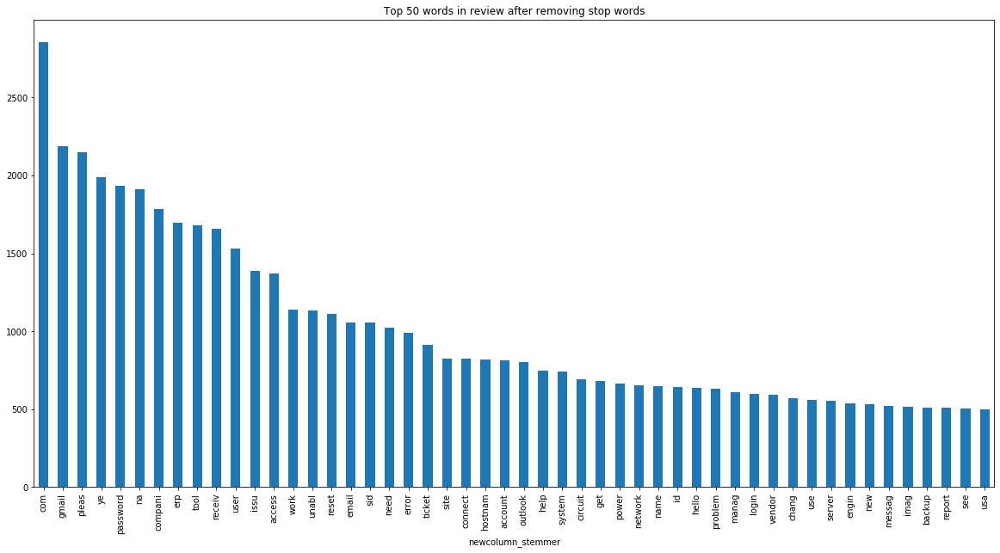

In [63]:
#To know the Distribution of Unigram
def get_top_n_words(corpus, n=None):
    vec = CountVectorizer().fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]

common_words = get_top_n_words(dataset['newcolumn_stemmer'], 50)

for word, freq in common_words:
    print(word, freq)

dataset1 = pd.DataFrame(common_words, columns = ['newcolumn_stemmer' , 'count'])

#Histogram for Count Distribution
plt.subplots(figsize=(20,10))

dataset1.groupby('newcolumn_stemmer').sum()['count'].sort_values(ascending=False).plot(kind='bar', title='Top 50 words in review after removing stop words')


#Only Considering Lemmatized Data For Analysis

In [64]:
#Function for Joining Lemmatized Data with Dataset
def cvt(txt):
    txt = " ".join(i for i in txt)
    return txt

In [65]:
#Joining with the Dataset
dataset['newcolumn'] = dataset['newcolumn'].apply(lambda X: cvt(X))

In [66]:
#Validating the Function
dataset['newcolumn'].iloc[0]

'login issue verified user detail employee manager name checked user name ad reset password advised user login check caller confirmed able login issue resolved'

gmail com 2190
yes na 1548
company com 501
cid image 475
backup circuit 435
engineering tool 406
com hello 395
password reset 385
reset password 365
collaboration platform 326
telecom vendor 321
na company 285
na yes 285
type outage 282
scheduled maintenance 282
image png 268
com mailto 258
erp sid 255
please help 243
circuit yes 238
password management 232
management tool 231
yes yes 230
error message 228
com hi 221
image jpg 211
internet explorer 192
inwarehouse tool 187
user id 182
tool password 176
sid sid 171
job scheduler 170
customer number 169
telephone summary 168
browser microsoft 167
microsoft internet 167
explorer email 167
com customer 167
probleme mit 167
pm et 166
language browser 166
global telecom 163
com dear 160
number telephone 159
telephony software 156
nwfodmhc exurcwkm 153
unable login 152
ticket global 152
na remote 147
vendor telecom 147


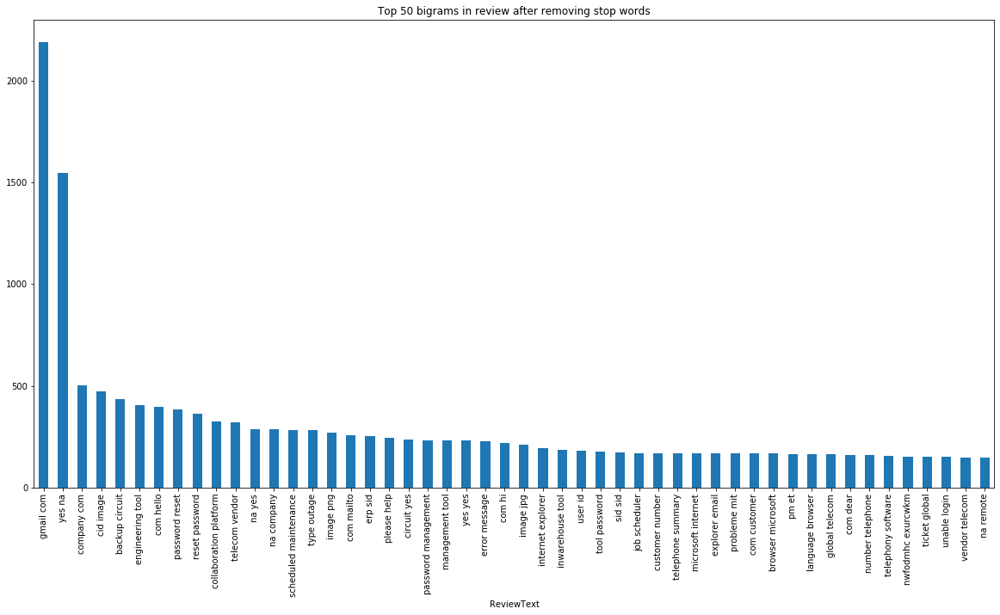

In [67]:
#The distribution of top bigrams before removing stop words
def get_top_n_bigram(corpus, n=None):
    vec = CountVectorizer(ngram_range=(2, 2)).fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]


common_words = get_top_n_bigram(dataset['newcolumn'], 50)


for word, freq in common_words:
    print(word, freq)


dataset3 = pd.DataFrame(common_words, columns = ['ReviewText' , 'count'])

#Histogram for Count Distribution
plt.subplots(figsize=(20,10))

dataset3.groupby('ReviewText').sum()['count'].sort_values(ascending=False).plot(kind='bar', title='Top 50 bigrams in review after removing stop words')


gmail com hello 373
na yes na 285
yes na company 281
cid image png 267
backup circuit yes 238
password management tool 231
yes yes na 227
cid image jpg 208
gmail com mailto 208
gmail com hi 207
browser microsoft internet 167
microsoft internet explorer 167
internet explorer email 167
com customer number 166
language browser microsoft 164
customer number telephone 159
gmail com customer 158
gmail com dear 157
number telephone summary 157
telecom vendor telecom 147
vendor telecom vendor 147
management tool password 145
site backup circuit 142
ticket global telecom 142
type outage network 141
power please specify 141
please specify type 141
specify type outage 141
type outage top 141
outage top cert 141
top cert site 141
yes na start 141
scheduled maintenance power 141
scheduled maintenance network 141
na company maint 141
company maint yes 141
maint yes provider 141
yes provider maint 141
provider maint ticket 141
site contact notified 141
contact notified phone 141
notified phone email 

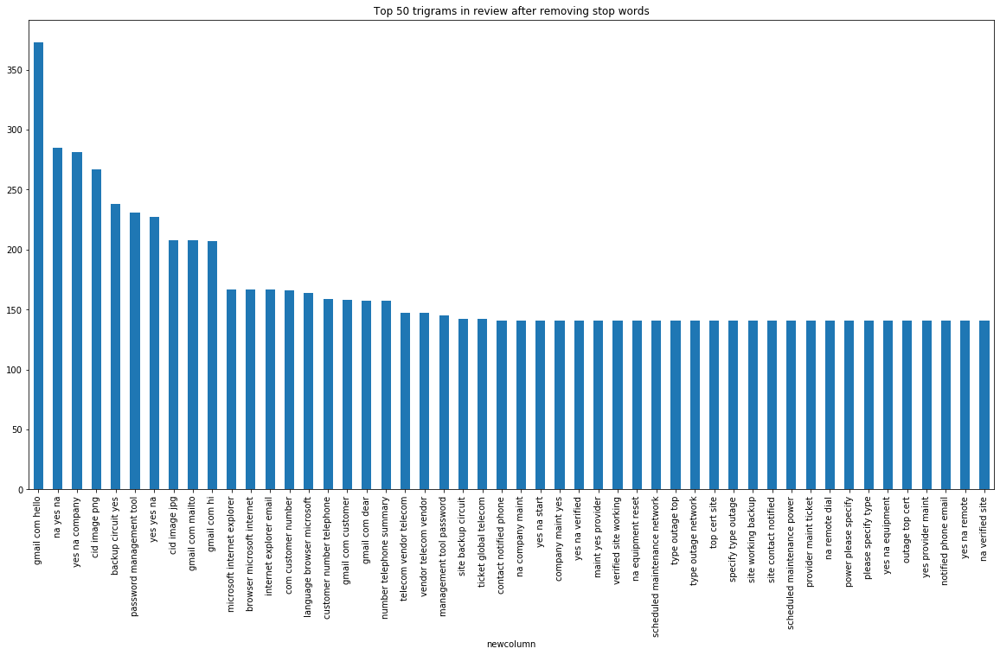

In [68]:
#The Distribution of Top Trigrams After Removing Stop Words
def get_top_n_trigram(corpus, n=None):
    vec = CountVectorizer(ngram_range=(3, 3)).fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0) 
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]

common_words = get_top_n_trigram(dataset['newcolumn'], 50)

for word, freq in common_words:
    print(word, freq)

dataset5 = pd.DataFrame(common_words, columns = ['newcolumn' , 'count'])

#Histogram for Count Distribution
plt.subplots(figsize=(20,10))

dataset5.groupby('newcolumn').sum()['count'].sort_values(ascending=False).plot(kind='bar',title='Top 50 trigrams in review after removing stop words')


In [69]:
#!pip install wordcloud

The below word cloud shows that the top words after applying all the cleaning activities.

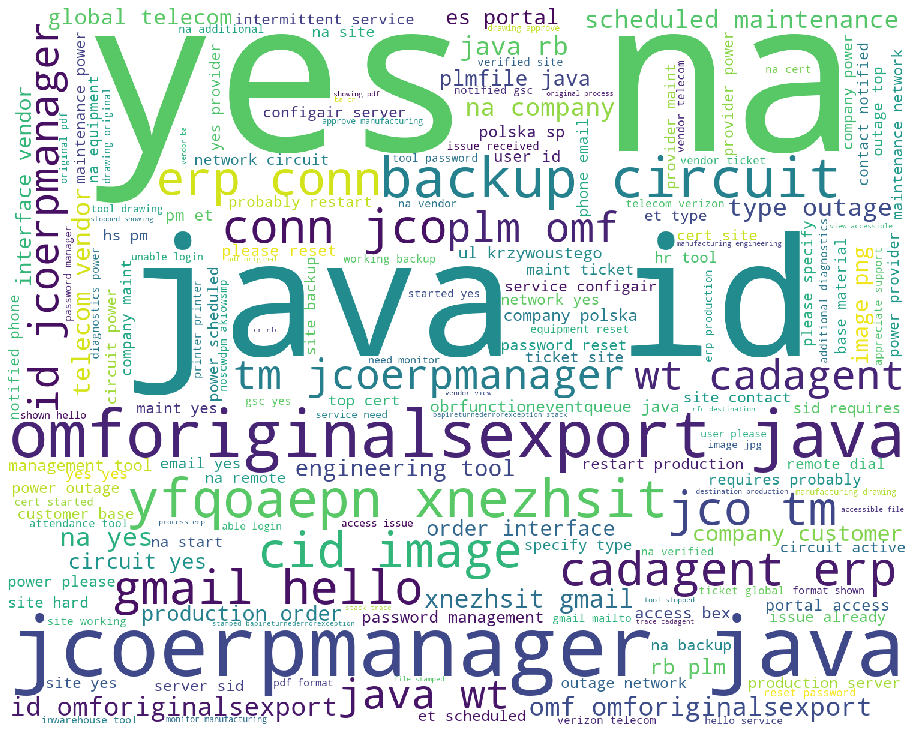

In [70]:
#For 2D graphs ploting
import matplotlib.pyplot as pPlot
#For Text Data Visualization
from wordcloud import WordCloud, STOPWORDS

#For Numerial Operations numpy(Numerical Python)
import numpy as npy

#For Image Processing PIL(Python Image Library)
from PIL import Image


ds_cloud = dataset['newcolumn'].head(100)



comment_words = ' '
stopwords = set(STOPWORDS) 
# iterate through the csv file 
for val in ds_cloud: 
    # typecaste each val to string
    val = str(val)
    # split the value 
    tokens = val.split()

    # Converts each token into lowercase
    for i in range(len(tokens)):
        tokens[i] = tokens[i].lower()
        for words in tokens:
            comment_words = comment_words + words + ' '

wordcloud = WordCloud(width = 1500, height = 1200,
                      background_color ='white',
                      stopwords = stopwords,
                      min_font_size = 10).generate(comment_words) 
# plot the WordCloud image
plt.figure(figsize = (20, 10), facecolor = None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad = 0)
plt.show()

# EDA END

# Milestone 2: Model Building

## Overview

● Building a model architecture which can classify.

● Trying different model architectures by researching state of the art for similar tasks.

● Train the model

● To deal with large training time, save the weights so that you can use them when
training the model for the second time without starting from scratch.



In [71]:
#To Know the Shape of the Dataframe
dataset.shape

(6475, 5)

In [72]:
#To View First 5 fields of Data
dataset.head()

,newcolumn,Assignment_group,newcolumn_len,word_count,newcolumn_stemmer
0,login issue verified user detail employee mana...,GRP_0,200,35,login issu verifi user detail employe manag na...
1,outlook received hmjdrvpb komuaywn gmail com h...,GRP_0,184,30,outlook receiv hmjdrvpb komuaywn gmail com hel...
2,cant log vpn received eylqgodm ybqkwiam gmail ...,GRP_0,91,19,cant log vpn receiv eylqgodm ybqkwiam gmail co...
3,unable access hr tool page unable access hr to...,GRP_0,59,12,unabl access hr tool page unabl access hr tool...
5,unable log engineering tool skype unable log e...,GRP_0,93,18,unabl log engin tool skype unabl log engin too...


In [73]:
#For Statistical Description
dataset.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
newcolumn_len,6475.0,233.692973,314.954020,3.0,89.0,155.0,262.5,7133.0
word_count,6475.0,40.240000,58.123146,1.0,14.0,27.0,45.0,1587.0


### <font color='green'><H1>========== Iteration - 1 ============</H1></font> 

# Analyzing With Orginal Dataset After EDA

### Spliting Dataset to account train, test, validation

In [74]:
#Assigning Independent and Dependent Columns
X = dataset['newcolumn']
y = dataset['Assignment_group']

In [75]:
#Spliting Train/Test data in 70:30 ratio
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=101)

#Spliting Train/Validation data in 70:30 ratio
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.3, random_state=101)

In [76]:
#To Print Train/Validation and Train/Test Data Shape
print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)
print(X_train.shape, X_val.shape, y_train.shape, y_val.shape)

(3172,) (1943,) (3172,) (1943,)
(3172,) (1360,) (3172,) (1360,)


In [77]:
#To Know Value Counts of Train Set
y_train.value_counts()

GRP_0     1441
GRP_8      141
GRP_24     127
GRP_2      119
GRP_12     115
GRP_19     112
GRP_3       96
GRP_13      65
GRP_14      61
GRP_25      55
GRP_4       52
GRP_33      51
GRP_29      49
GRP_16      47
GRP_34      40
GRP_18      38
GRP_10      33
GRP_7       32
GRP_6       32
GRP_9       30
GRP_41      27
GRP_26      25
GRP_17      24
GRP_31      24
GRP_15      23
GRP_22      18
GRP_11      17
GRP_28      17
GRP_42      16
GRP_23      16
          ... 
GRP_47       8
GRP_45       8
GRP_65       7
GRP_37       7
GRP_39       6
GRP_36       6
GRP_53       6
GRP_48       5
GRP_50       5
GRP_51       5
GRP_60       5
GRP_49       4
GRP_46       4
GRP_55       4
GRP_52       3
GRP_66       3
GRP_68       3
GRP_59       3
GRP_58       2
GRP_69       2
GRP_38       2
GRP_71       2
GRP_32       2
GRP_43       2
GRP_67       1
GRP_73       1
GRP_57       1
GRP_70       1
GRP_54       1
GRP_56       1
Name: Assignment_group, Length: 69, dtype: int64

In [78]:
#To Build Recurrent Units
Encoder = LabelEncoder()
y_train_en = Encoder.fit_transform(y_train)
y_test_en = Encoder.fit_transform(y_test)
y_val_en = Encoder.fit_transform(y_val)

<p style="font-family: Arial; font-size:1.4em;color:blue;"> ---------- Building naive bayes classifier On Actual Data ------------ </p>

In [79]:
#To Transform a Corpora of Text to a Vector of Term/Token Counts
from sklearn.feature_extraction.text import CountVectorizer
#To Find NB of Descrete Features
from sklearn.naive_bayes import MultinomialNB
#To Find the Accuracy of the Model Built
from sklearn.metrics import accuracy_score 

In [80]:
vector = CountVectorizer().fit(X_train)
X_train_vectorized = vector.transform(X_train)
classifier = MultinomialNB(alpha=0.1)
classifier.fit(X_train_vectorized, y_train_en)
X_test_vectorized = vector.transform(X_test)
preds = classifier.predict(vector.transform(X_test))
train_score = accuracy_score(y_train_en, classifier.predict(X_train_vectorized))
test_score = accuracy_score(y_test_en, preds)
print('Train_score: ',train_score,'\n Test_score: ', test_score)

Train_score:  0.9013240857503153 
 Test_score:  0.5717961914565105


In [81]:
#To Collect Desired Data in Specific DataType
import collections
collections.Counter(preds)

Counter({55: 36,
         11: 72,
         0: 1016,
         67: 62,
         17: 116,
         23: 59,
         22: 31,
         12: 42,
         6: 39,
         27: 45,
         14: 5,
         33: 34,
         34: 2,
         68: 12,
         10: 25,
         4: 49,
         8: 39,
         44: 31,
         54: 2,
         19: 10,
         20: 4,
         15: 7,
         18: 18,
         5: 51,
         7: 3,
         46: 1,
         21: 9,
         1: 5,
         39: 2,
         9: 25,
         28: 15,
         63: 20,
         35: 10,
         58: 2,
         2: 12,
         57: 4,
         40: 1,
         3: 2,
         13: 3,
         16: 6,
         25: 2,
         36: 6,
         29: 2,
         24: 1,
         48: 1,
         41: 1,
         62: 1,
         56: 1,
         30: 1})

In [82]:
#orginal dataset title+description
#Train_score:  0.9013240857503153 
#Test_score:  0.5717961914565105

# only description
#Train_score:  0.8857327307940607 
# Test_score:  0.5774499473129611

# non group 0
#Train_score:  0.9181818181818182 
# Test_score:  0.41641938674579626

In [83]:
#Text Report to Show Main Classification Metrics
from sklearn.metrics import classification_report

# Classification report
print("Classification report")
print(classification_report(y_test_en,preds))

Classification report
              precision    recall  f1-score   support

           0       0.72      0.80      0.76       917
           1       0.20      0.25      0.22         4
           2       0.67      0.36      0.47        22
           3       0.50      0.10      0.17        10
           4       0.71      0.49      0.58        71
           5       0.49      0.62      0.55        40
           6       0.38      0.42      0.40        36
           7       0.33      0.14      0.20         7
           8       0.33      0.54      0.41        24
           9       0.64      0.76      0.70        21
          10       0.36      0.36      0.36        25
          11       0.35      0.38      0.36        65
          12       0.67      0.44      0.53        64
          13       0.33      0.08      0.12        13
          14       0.60      0.38      0.46         8
          15       0.43      0.38      0.40         8
          16       0.33      0.67      0.44         3
     

/Users/thani/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/Users/thani/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1439: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)


In [84]:
#  accuracy                           0.57      1943
#   macro avg       0.28      0.24      0.23      1943
# weighted avg       0.55      0.57      0.55      1943





Building Ensemble Bayes Classifier On Actual Data

In [85]:
#To Build a DecisionTreeClassifier Model
from sklearn.tree import DecisionTreeClassifier

In [86]:
dt_model = DecisionTreeClassifier(criterion = 'entropy' )

In [87]:
dt_model.fit(X_train_vectorized, y_train_en)

DecisionTreeClassifier(class_weight=None, criterion='entropy', max_depth=None,
                       max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort=False,
                       random_state=None, splitter='best')

In [88]:
#https://medium.com/@rnbrown/creating-and-visualizing-decision-trees-with-python-f8e8fa394176
#https://stackoverflow.com/questions/36979421/how-can-i-use-conda-to-install-pydotplus

#To Read and Write String Files 
from sklearn.externals.six import StringIO  
#To Display an Image from a File on Jupyter Notebook 
from IPython.display import Image
#To Visualize Decision Tree  
from sklearn.tree import export_graphviz
#For Python Interface to Graphviz’s Dot language
import pydotplus

dot_data = StringIO()

export_graphviz(dt_model, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True)

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

/Users/thani/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/externals/six.py:31: DeprecationWarning: The module is deprecated in version 0.21 and will be removed in version 0.23 since we've dropped support for Python 2.7. Please rely on the official version of six (https://pypi.org/project/six/).
  "(https://pypi.org/project/six/).", DeprecationWarning)


dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.168669 to fit



In [89]:
y_predict = dt_model.predict(X_test_vectorized)

In [90]:
# calculate accuracy measures and confusion matrix
from sklearn import metrics

In [91]:
print(dt_model.score(X_train_vectorized , y_train_en))
print(dt_model.score(X_test_vectorized , y_test_en))

0.9993694829760403
0.503345342254246


In [92]:
#0.9993694829760403
#0.49871332990221307

<p style="font-family: Arial; font-size:1.4em;color:blue;"> ---------- Multi Class Text Classification using LSTM - TensorFlow 2.0 ------------ </p>

In [93]:
#!pip install keras
#!pip install tensorflow

In [94]:
#To Transform a Corpora of Text to a Vector of Term/Token Counts
from sklearn.feature_extraction.text import CountVectorizer
#For Ease Use of TensorFlow
import keras
#To Create Tokens
from keras.preprocessing.text import Tokenizer
#To Build Pad Sequence Model
from keras.preprocessing.sequence import pad_sequences
#To Build a Sequential Model
from keras.models import Sequential, Model
#Importing Necessary NN and NLP Modules
from keras.layers import Dense, Activation, GlobalMaxPool1D, Dropout, Embedding, LSTM, Input, SpatialDropout1D, Reshape
#To Convert class vectors(integers) to class matrix
from keras.utils.np_utils import to_categorical
#For Regular Expression Operations
import re

Using TensorFlow backend.


In [95]:
# ---------------------------------------------------------------
# ---------------------------------------------------------------
# ---------------------------------------------------------------
# need to see if possible we can add this.

In [96]:
# The maximum number of words to be used. (most frequent)
MAX_NB_WORDS = 30000
# Max number of words in each complaint.
MAX_SEQUENCE_LENGTH = 150
# This is fixed.
EMBEDDING_DIM = 100




In [97]:
#Applying Tokanizer Function
tokenizer = Tokenizer(num_words=MAX_NB_WORDS, filters='!"#$%&()*+,-./:;<=>?@[\]^_`{|}~', lower=True)
tokenizer.fit_on_texts(dataset['newcolumn'].values)
word_index = tokenizer.word_index
print('Found %s unique tokens.' % len(word_index))

Found 14210 unique tokens.


In [98]:
#To know the Tokens Vocabulary Size
vocab_size = len(tokenizer.word_index.keys()) 
print(vocab_size)

14210


In [99]:
#Formulating Independent Tokens and Know it's Shape
X = tokenizer.texts_to_sequences(dataset['newcolumn'].values)

X = pad_sequences(X, maxlen=MAX_SEQUENCE_LENGTH)
print('Shape of data tensor:', X.shape)

Shape of data tensor: (6475, 150)


In [100]:
#Formulating Dependent Tokens and Know it's Shape
Y = pd.get_dummies(dataset['Assignment_group']).values
print('Shape of label tensor:', Y.shape)

Shape of label tensor: (6475, 74)


In [101]:
#Assigning Train Data, Test Data, Validation Data and Printing there Sizes
X_train, X_test, Y_train, Y_test = train_test_split(X,Y, test_size = 0.30, random_state = 121)

print(X_train.shape,Y_train.shape)
print(X_test.shape,Y_test.shape)

X_test, X_val, Y_test, Y_val = train_test_split(X_test,Y_test, test_size = 0.30, random_state = 121)

print(X_train.shape,Y_train.shape)
print(X_test.shape,Y_test.shape)
print(X_val.shape,Y_val.shape)


(4532, 150) (4532, 74)
(1943, 150) (1943, 74)
(4532, 150) (4532, 74)
(1360, 150) (1360, 74)
(583, 150) (583, 74)


In [102]:
#Visualixing Sample Train Data
y_train.head()

2581     GRP_0
169      GRP_0
2782     GRP_0
7792    GRP_42
6530     GRP_0
Name: Assignment_group, dtype: object

In [103]:
#Model Building
def class_identify():
    model = Sequential()
    sequence_input = Input(shape=(MAX_SEQUENCE_LENGTH,), dtype='int32')
    layer = Embedding(vocab_size+1, 100, input_length=MAX_SEQUENCE_LENGTH, trainable=True)(sequence_input)
    layer = SpatialDropout1D(0.4)(layer)
    layer = LSTM(100, dropout=0.2, recurrent_dropout=0.2)(layer)
    prediction = Dense(74, activation='softmax')(layer)
    model = Model(sequence_input, prediction)
    model.compile(loss='categorical_crossentropy', optimizer='adam',metrics=['accuracy'])
    return model

model = class_identify()
model.summary()


Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         (None, 150)               0         
_________________________________________________________________
embedding_1 (Embedding)      (None, 150, 100)          1421100   
_________________________________________________________________
spatial_dropout1d_1 (Spatial (None, 150, 100)          0         
_________________________________________________________________
lstm_1 (LSTM)                (None, 100)               80400     
_________________________________________________________________
dense_1 (Dense)              (None, 74)                7474      
Total params: 1,508,974
Trainable params: 1,508,974
Non-trainable params: 0
_________________________________________________________________


In [104]:
model.compile(optimizer='adam', loss='binary_crossentropy', metrics = ['accuracy'])

In [105]:
#Running Model
history = model.fit(X_train, Y_train, epochs = 10, batch_size=128, validation_data=(X_test, Y_test))

/Users/thani/anaconda3/anaconda3/lib/python3.7/site-packages/tensorflow_core/python/framework/indexed_slices.py:433: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "


Train on 4532 samples, validate on 1360 samples
Epoch 1/10
4532/4532 [==============================] - 10s 2ms/step - loss: 0.0579 - accuracy: 0.9863 - val_loss: 0.0468 - val_accuracy: 0.9865
Epoch 2/10
4532/4532 [==============================] - 10s 2ms/step - loss: 0.0471 - accuracy: 0.9868 - val_loss: 0.0456 - val_accuracy: 0.9872
Epoch 3/10
4532/4532 [==============================] - 10s 2ms/step - loss: 0.0462 - accuracy: 0.9878 - val_loss: 0.0442 - val_accuracy: 0.9888
Epoch 4/10
4532/4532 [==============================] - 10s 2ms/step - loss: 0.0433 - accuracy: 0.9894 - val_loss: 0.0417 - val_accuracy: 0.9896
Epoch 5/10
4532/4532 [==============================] - 10s 2ms/step - loss: 0.0403 - accuracy: 0.9903 - val_loss: 0.0402 - val_accuracy: 0.9901
Epoch 6/10
4532/4532 [==============================] - 10s 2ms/step - loss: 0.0379 - accuracy: 0.9910 - val_loss: 0.0398 - val_accuracy: 0.9900
Epoch 7/10
4532/4532 [==============================] - 9s 2ms/step - loss: 0.0358

### <font color='green'><H1>========== Iteration - 2 ============</H1></font> 

# Analyzing Other Than "Assignment_group" 'GRP_0'

In [106]:
df_0 = dataset[dataset['Assignment_group'].str.contains('GRP_0')].copy()
df_no_0 = dataset[~dataset['Assignment_group'].str.contains('GRP_0')].copy()

### Spliting Dataset To Account Train, Test And Validation

In [107]:
X = df_no_0['newcolumn']
y = df_no_0['Assignment_group']

In [108]:
print(X.shape, y.shape)

(3473,) (3473,)


In [109]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=101)

X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.3, random_state=101)

In [110]:
print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)
print(X_train.shape, X_val.shape, y_train.shape, y_val.shape)

(1701,) (1042,) (1701,) (1042,)
(1701,) (730,) (1701,) (730,)


In [111]:
y_train.value_counts()

GRP_8     131
GRP_24    130
GRP_19    114
GRP_12    111
GRP_2     109
GRP_3     106
GRP_13     70
GRP_14     61
GRP_25     60
GRP_33     59
GRP_29     46
GRP_16     45
GRP_18     40
GRP_10     40
GRP_4      38
GRP_17     33
GRP_7      32
GRP_6      30
GRP_26     30
GRP_34     30
GRP_9      25
GRP_31     25
GRP_15     24
GRP_40     21
GRP_28     20
GRP_42     19
GRP_45     18
GRP_11     18
GRP_5      17
GRP_41     17
         ... 
GRP_1      11
GRP_62     10
GRP_50      9
GRP_47      8
GRP_30      8
GRP_65      7
GRP_36      6
GRP_44      5
GRP_52      5
GRP_48      5
GRP_53      5
GRP_39      4
GRP_27      4
GRP_37      4
GRP_49      4
GRP_43      3
GRP_60      3
GRP_51      3
GRP_55      2
GRP_38      2
GRP_69      2
GRP_59      2
GRP_66      2
GRP_68      2
GRP_46      2
GRP_64      1
GRP_54      1
GRP_56      1
GRP_61      1
GRP_32      1
Name: Assignment_group, Length: 64, dtype: int64

In [112]:
Encoder = LabelEncoder()
y_train_en = Encoder.fit_transform(y_train)
y_test_en = Encoder.fit_transform(y_test)
y_val_en = Encoder.fit_transform(y_val)

<p style="font-family: Arial; font-size:1.4em;color:blue;"> ---------- Building naive bayes classifier On Actual Data ------------ </p>

In [113]:
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import accuracy_score 

In [114]:
vector = CountVectorizer().fit(X_train)
X_train_vectorized = vector.transform(X_train)
classifier = MultinomialNB(alpha=0.1)
classifier.fit(X_train_vectorized, y_train_en)
X_test_vectorized = vector.transform(X_test)
preds = classifier.predict(vector.transform(X_test))
train_score = accuracy_score(y_train_en, classifier.predict(X_train_vectorized))
test_score = accuracy_score(y_test_en, preds)
print('Train_score: ',train_score,'\n Test_score: ', test_score)

Train_score:  0.934156378600823 
 Test_score:  0.3915547024952015


In [115]:
import collections
collections.Counter(preds)

Counter({43: 23,
         8: 19,
         62: 69,
         57: 3,
         4: 68,
         7: 45,
         10: 95,
         22: 59,
         3: 53,
         1: 25,
         9: 27,
         52: 29,
         21: 29,
         16: 93,
         11: 65,
         26: 44,
         18: 17,
         12: 4,
         27: 14,
         63: 27,
         2: 6,
         35: 9,
         17: 31,
         6: 11,
         40: 5,
         32: 32,
         5: 38,
         34: 10,
         55: 4,
         61: 29,
         33: 13,
         13: 4,
         23: 2,
         15: 4,
         38: 8,
         24: 1,
         28: 2,
         0: 6,
         20: 3,
         31: 1,
         30: 1,
         14: 4,
         44: 2,
         41: 2,
         37: 1,
         29: 1,
         53: 1,
         60: 2,
         47: 1})

In [116]:
from sklearn.metrics import classification_report

# Classification report
print("Classification report")
print(classification_report(y_test_en,preds))

Classification report
              precision    recall  f1-score   support

           0       0.67      0.50      0.57         8
           1       0.28      0.44      0.34        16
           2       0.33      0.29      0.31         7
           3       0.58      0.41      0.48        76
           4       0.32      0.52      0.40        42
           5       0.42      0.59      0.49        27
           6       0.36      0.57      0.44         7
           7       0.44      0.80      0.57        25
           8       0.74      0.93      0.82        15
           9       0.37      0.53      0.43        19
          10       0.40      0.70      0.51        54
          11       0.65      0.65      0.65        65
          12       0.25      0.08      0.12        13
          13       0.00      0.00      0.00         7
          14       0.50      0.22      0.31         9
          15       1.00      0.80      0.89         5
          16       0.86      0.90      0.88        89
     

/Users/thani/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
/Users/thani/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1439: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples.
  'recall', 'true', average, warn_for)


<p style="font-family: Arial; font-size:1.4em;color:blue;"> ---------- Building ensemble bayes classifier On Actual Data ------------ </p>

In [117]:
#!pip install pydotplus
#!pip install GraphViz

In [118]:
from sklearn.tree import DecisionTreeClassifier

In [119]:
dt_model = DecisionTreeClassifier(criterion = 'entropy' )

In [120]:
dt_model.fit(X_train_vectorized, y_train_en)

DecisionTreeClassifier(class_weight=None, criterion='entropy', max_depth=None,
                       max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort=False,
                       random_state=None, splitter='best')

In [121]:
#https://medium.com/@rnbrown/creating-and-visualizing-decision-trees-with-python-f8e8fa394176
#https://stackoverflow.com/questions/36979421/how-can-i-use-conda-to-install-pydotplus

from sklearn.externals.six import StringIO  
from IPython.display import Image  
from sklearn.tree import export_graphviz
import pydotplus

dot_data = StringIO()

export_graphviz(dt_model, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True)

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.190485 to fit



In [122]:
y_predict = dt_model.predict(X_test_vectorized)

In [123]:
# calculate accuracy measures and confusion matrix
from sklearn import metrics

In [124]:
print(dt_model.score(X_train_vectorized , y_train_en))
print(dt_model.score(X_test_vectorized , y_test_en))

1.0
0.2523992322456814


In [125]:
#0.9993694829760403
#0.49871332990221307

<p style="font-family: Arial; font-size:1.4em;color:blue;"> ---------- Multi Class Text Classification using LSTM - TensorFlow 2.0 ------------ </p>

In [126]:
# ---------------------------------------------------------------
# ---------------------------------------------------------------
# ---------------------------------------------------------------
# need to see if possible we can add this.

In [127]:
from sklearn.feature_extraction.text import CountVectorizer
import keras
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from keras.models import Sequential, Model
from keras.layers import Dense, Activation, GlobalMaxPool1D, Dropout, Embedding, LSTM, Input, SpatialDropout1D, Reshape
from keras.utils.np_utils import to_categorical
import re

In [128]:
# The maximum number of words to be used. (most frequent)
MAX_NB_WORDS = 30000
# Max number of words in each complaint.
MAX_SEQUENCE_LENGTH = 150
# This is fixed.
EMBEDDING_DIM = 100




In [129]:
tokenizer = Tokenizer(num_words=MAX_NB_WORDS, filters='!"#$%&()*+,-./:;<=>?@[\]^_`{|}~', lower=True)
tokenizer.fit_on_texts(df_no_0['newcolumn'].values)
word_index = tokenizer.word_index
print('Found %s unique tokens.' % len(word_index))

Found 10792 unique tokens.


In [130]:
vocab_size = len(tokenizer.word_index.keys()) 
print(vocab_size)

10792


In [131]:
X = tokenizer.texts_to_sequences(df_no_0['newcolumn'].values)

X = pad_sequences(X, maxlen=MAX_SEQUENCE_LENGTH)
print('Shape of data tensor:', X.shape)

Shape of data tensor: (3473, 150)


In [132]:
Y = pd.get_dummies(df_no_0['Assignment_group']).values
print('Shape of label tensor:', Y.shape)

Shape of label tensor: (3473, 73)


In [133]:
X_train, X_test, Y_train, Y_test = train_test_split(X,Y, test_size = 0.30, random_state = 121)

print(X_train.shape,Y_train.shape)
print(X_test.shape,Y_test.shape)

X_test, X_val, Y_test, Y_val = train_test_split(X_test,Y_test, test_size = 0.30, random_state = 121)

print(X_train.shape,Y_train.shape)
print(X_test.shape,Y_test.shape)
print(X_val.shape,Y_val.shape)

(2431, 150) (2431, 73)
(1042, 150) (1042, 73)
(2431, 150) (2431, 73)
(729, 150) (729, 73)
(313, 150) (313, 73)


In [134]:
#X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=101)

#X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.3, random_state=101)

In [135]:
# ---------------------------------------------------------------
# ---------------------------------------------------------------
# ---------------------------------------------------------------

In [136]:
#X_train.head()

In [137]:
y_train.head()

6905    GRP_12
5721    GRP_24
5036     GRP_2
7907    GRP_15
5215     GRP_3
Name: Assignment_group, dtype: object

In [138]:
def class_identify():
    model = Sequential()
    sequence_input = Input(shape=(MAX_SEQUENCE_LENGTH,), dtype='int32')
    layer = Embedding(vocab_size+1, 100, input_length=MAX_SEQUENCE_LENGTH, trainable=True)(sequence_input)
    layer = SpatialDropout1D(0.4)(layer)
    layer = LSTM(100, dropout=0.2, recurrent_dropout=0.2)(layer)
    prediction = Dense(73, activation='softmax')(layer)
    model = Model(sequence_input, prediction)
    model.compile(loss='categorical_crossentropy', optimizer='adam',metrics=['accuracy'])
    return model

model = class_identify()
model.summary()


Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         (None, 150)               0         
_________________________________________________________________
embedding_2 (Embedding)      (None, 150, 100)          1079300   
_________________________________________________________________
spatial_dropout1d_2 (Spatial (None, 150, 100)          0         
_________________________________________________________________
lstm_2 (LSTM)                (None, 100)               80400     
_________________________________________________________________
dense_2 (Dense)              (None, 73)                7373      
Total params: 1,167,073
Trainable params: 1,167,073
Non-trainable params: 0
_________________________________________________________________


In [139]:
model.compile(optimizer='adam', loss='binary_crossentropy', metrics = ['accuracy'])

In [140]:
history = model.fit(X_train, Y_train, epochs = 10, batch_size=128, validation_data=(X_test, Y_test))

/Users/thani/anaconda3/anaconda3/lib/python3.7/site-packages/tensorflow_core/python/framework/indexed_slices.py:433: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "


Train on 2431 samples, validate on 729 samples
Epoch 1/10
2431/2431 [==============================] - 6s 2ms/step - loss: 0.0713 - accuracy: 0.9863 - val_loss: 0.0668 - val_accuracy: 0.9863
Epoch 2/10
2431/2431 [==============================] - 5s 2ms/step - loss: 0.0640 - accuracy: 0.9863 - val_loss: 0.0622 - val_accuracy: 0.9863
Epoch 3/10
2431/2431 [==============================] - 5s 2ms/step - loss: 0.0623 - accuracy: 0.9863 - val_loss: 0.0618 - val_accuracy: 0.9863
Epoch 4/10
2431/2431 [==============================] - 5s 2ms/step - loss: 0.0618 - accuracy: 0.9863 - val_loss: 0.0611 - val_accuracy: 0.9863
Epoch 5/10
2431/2431 [==============================] - 5s 2ms/step - loss: 0.0607 - accuracy: 0.9863 - val_loss: 0.0594 - val_accuracy: 0.9868
Epoch 6/10
2431/2431 [==============================] - 5s 2ms/step - loss: 0.0586 - accuracy: 0.9868 - val_loss: 0.0570 - val_accuracy: 0.9870
Epoch 7/10
2431/2431 [==============================] - 5s 2ms/step - loss: 0.0564 - accu

### <font color='green'><H1>========== Iteration - 3 ============</H1></font> 

# Applying By Merging 'GRP_0' Data

In [141]:
#df_0 = dataset[dataset['Assignment_group'].str.contains('GRP_0')].copy()
#df_no_0 = dataset[~dataset['Assignment_group'].str.contains('GRP_0')].copy()

In [142]:
dataset.head()

,newcolumn,Assignment_group,newcolumn_len,word_count,newcolumn_stemmer
0,login issue verified user detail employee mana...,GRP_0,200,35,login issu verifi user detail employe manag na...
1,outlook received hmjdrvpb komuaywn gmail com h...,GRP_0,184,30,outlook receiv hmjdrvpb komuaywn gmail com hel...
2,cant log vpn received eylqgodm ybqkwiam gmail ...,GRP_0,91,19,cant log vpn receiv eylqgodm ybqkwiam gmail co...
3,unable access hr tool page unable access hr to...,GRP_0,59,12,unabl access hr tool page unabl access hr tool...
5,unable log engineering tool skype unable log e...,GRP_0,93,18,unabl log engin tool skype unabl log engin too...


In [143]:
df_0 = dataset[dataset['Assignment_group'].str.contains('GRP_0')].copy()
df_no_0 = dataset[~dataset['Assignment_group'].str.contains('GRP_0')].copy()

In [144]:
df_0['d1'] = df_0.newcolumn.str.split().str.get(0)+" "+df_0.newcolumn.str.split().str.get(1)

In [145]:
df_0.head()

,newcolumn,Assignment_group,newcolumn_len,word_count,newcolumn_stemmer,d1
0,login issue verified user detail employee mana...,GRP_0,200,35,login issu verifi user detail employe manag na...,login issue
1,outlook received hmjdrvpb komuaywn gmail com h...,GRP_0,184,30,outlook receiv hmjdrvpb komuaywn gmail com hel...,outlook received
2,cant log vpn received eylqgodm ybqkwiam gmail ...,GRP_0,91,19,cant log vpn receiv eylqgodm ybqkwiam gmail co...,cant log
3,unable access hr tool page unable access hr to...,GRP_0,59,12,unabl access hr tool page unabl access hr tool...,unable access
5,unable log engineering tool skype unable log e...,GRP_0,93,18,unabl log engin tool skype unabl log engin too...,unable log


In [146]:
a = df_0['d1'].unique()

In [147]:
print(size(a))

1596


In [148]:
#df_abc = df_0.replace().groupby('d1',as_index=False).agg(''.join) 

df_0_1 = df_0.replace().groupby('d1', as_index=False).agg({'newcolumn' : ' '.join, 'Assignment_group' : 'first'}) 

In [149]:
df_0_1.head()

,d1,newcolumn,Assignment_group
0,abap runtime,abap runtime error transaction zload system si...,GRP_0
1,able access,able access walkme plugin every time click wal...,GRP_0
2,able add,able add lean project collaboration platform r...,GRP_0
3,able apply,able apply job company portal external user ab...,GRP_0
4,able connect,able connect vpn able connect vpn able connect...,GRP_0


In [150]:
dataset_balanced_v1 = pd.concat([df_0_1,df_no_0])

/Users/thani/anaconda3/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  """Entry point for launching an IPython kernel.


In [151]:
from sklearn.utils import shuffle
dataset_balanced_v1 = shuffle(dataset_balanced_v1)

In [152]:
dataset_balanced_v1.shape

(5068, 6)

In [153]:
dataset_balanced_v1.head()

,Assignment_group,d1,newcolumn,newcolumn_len,newcolumn_stemmer,word_count
6643,GRP_24,NaN,l fter defekt rechner f r video berwachung l f...,85.0,l fter defekt rechner f r video berwachung l f...,16.0
321,GRP_0,display monitor,display monitor display monitor,NaN,NaN,NaN
184,GRP_0,cannot login,cannot login good morning cannot login sid due...,NaN,NaN,NaN
1469,GRP_0,user vvhthyoffc,user vvhthyoffc blocked citrix user vvbthryhn ...,NaN,NaN,NaN
3013,GRP_18,NaN,another shipment process commodity detail erro...,156.0,anoth shipment process commod detail error inc...,28.0


### Spliting Dataset To Account Train, Test And Validation

In [154]:
X = dataset_balanced_v1['newcolumn']
y = dataset_balanced_v1['Assignment_group']

In [155]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=101)

X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.3, random_state=101)

In [156]:
print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)
print(X_train.shape, X_val.shape, y_train.shape, y_val.shape)

(2482,) (1521,) (2482,) (1521,)
(2482,) (1065,) (2482,) (1065,)


In [157]:
y_train.value_counts()

GRP_0     766
GRP_8     143
GRP_24    139
GRP_12    117
GRP_19    111
GRP_2     106
GRP_3     103
GRP_13     76
GRP_25     60
GRP_33     53
GRP_14     48
GRP_4      47
GRP_29     47
GRP_16     45
GRP_10     43
GRP_6      35
GRP_18     33
GRP_9      31
GRP_34     30
GRP_31     28
GRP_7      28
GRP_17     28
GRP_40     24
GRP_26     22
GRP_28     21
GRP_20     19
GRP_42     19
GRP_45     18
GRP_5      18
GRP_41     18
         ... 
GRP_11     11
GRP_27      9
GRP_30      9
GRP_37      8
GRP_55      7
GRP_44      7
GRP_51      6
GRP_36      6
GRP_47      6
GRP_39      6
GRP_65      5
GRP_50      5
GRP_53      5
GRP_52      4
GRP_46      3
GRP_66      3
GRP_60      3
GRP_48      3
GRP_56      2
GRP_54      2
GRP_32      2
GRP_58      2
GRP_59      2
GRP_63      2
GRP_49      2
GRP_64      1
GRP_69      1
GRP_43      1
GRP_67      1
GRP_57      1
Name: Assignment_group, Length: 66, dtype: int64

In [158]:
Encoder = LabelEncoder()
y_train_en = Encoder.fit_transform(y_train)
y_test_en = Encoder.fit_transform(y_test)
y_val_en = Encoder.fit_transform(y_val)

<p style="font-family: Arial; font-size:1.4em;color:blue;"> ---------- Building naive bayes classifier On Actual Data ------------ </p>

In [159]:
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import accuracy_score 

In [160]:
vector = CountVectorizer().fit(X_train)
X_train_vectorized = vector.transform(X_train)
classifier = MultinomialNB(alpha=0.1)
classifier.fit(X_train_vectorized, y_train_en)
X_test_vectorized = vector.transform(X_test)
preds = classifier.predict(vector.transform(X_test))
train_score = accuracy_score(y_train_en, classifier.predict(X_train_vectorized))
test_score = accuracy_score(y_test_en, preds)
print('Train_score: ',train_score,'\n Test_score: ', test_score)

Train_score:  0.8936341659951652 
 Test_score:  0.48652202498356345


In [161]:
import collections
collections.Counter(preds)

Counter({0: 594,
         19: 20,
         27: 47,
         6: 38,
         11: 83,
         4: 72,
         64: 51,
         54: 23,
         17: 82,
         5: 70,
         12: 56,
         62: 4,
         22: 23,
         33: 11,
         23: 52,
         9: 26,
         37: 2,
         35: 5,
         65: 20,
         32: 38,
         10: 29,
         56: 2,
         31: 2,
         43: 19,
         25: 1,
         21: 7,
         8: 35,
         18: 24,
         38: 1,
         34: 9,
         2: 14,
         28: 6,
         14: 4,
         15: 2,
         13: 6,
         63: 20,
         1: 6,
         47: 1,
         30: 2,
         7: 4,
         20: 1,
         16: 6,
         46: 1,
         29: 1,
         44: 1})

In [162]:
from sklearn.metrics import classification_report

# Classification report
print("Classification report")
print(classification_report(y_test_en,preds))

Classification report
              precision    recall  f1-score   support

           0       0.60      0.71      0.65       499
           1       0.17      0.17      0.17         6
           2       0.43      0.30      0.35        20
           3       0.00      0.00      0.00        14
           4       0.57      0.59      0.58        70
           5       0.33      0.70      0.45        33
           6       0.34      0.41      0.37        32
           7       0.50      0.14      0.22        14
           8       0.40      0.52      0.45        27
           9       0.65      1.00      0.79        17
          10       0.31      0.32      0.32        28
          11       0.41      0.51      0.45        67
          12       0.57      0.42      0.48        77
          13       0.17      0.17      0.17         6
          14       0.00      0.00      0.00         7
          15       0.50      0.10      0.17        10
          16       0.33      0.40      0.36         5
     

/Users/thani/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


<p style="font-family: Arial; font-size:1.4em;color:blue;"> ---------- Building ensemble bayes classifier On Actual Data ------------ </p>

In [163]:
from sklearn.tree import DecisionTreeClassifier

In [164]:
dt_model = DecisionTreeClassifier(criterion = 'entropy' )

In [165]:
dt_model.fit(X_train_vectorized, y_train_en)

DecisionTreeClassifier(class_weight=None, criterion='entropy', max_depth=None,
                       max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort=False,
                       random_state=None, splitter='best')

In [166]:
#https://medium.com/@rnbrown/creating-and-visualizing-decision-trees-with-python-f8e8fa394176
#https://stackoverflow.com/questions/36979421/how-can-i-use-conda-to-install-pydotplus

from sklearn.externals.six import StringIO  
from IPython.display import Image  
from sklearn.tree import export_graphviz
import pydotplus

dot_data = StringIO()

export_graphviz(dt_model, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True)

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.169792 to fit



In [167]:
y_predict = dt_model.predict(X_test_vectorized)

In [168]:
# calculate accuracy measures and confusion matrix
from sklearn import metrics

In [169]:
print(dt_model.score(X_train_vectorized , y_train_en))
print(dt_model.score(X_test_vectorized , y_test_en))

0.9991941982272361
0.398422090729783


<p style="font-family: Arial; font-size:1.4em;color:blue;"> ---------- Multi Class Text Classification using LSTM - TensorFlow 2.0 ------------ </p>

In [170]:
# ---------------------------------------------------------------
# ---------------------------------------------------------------
# ---------------------------------------------------------------
# need to see if possible we can add this.

In [171]:
# The maximum number of words to be used. (most frequent)
MAX_NB_WORDS = 30000
# Max number of words in each complaint.
MAX_SEQUENCE_LENGTH = 150
# This is fixed.
EMBEDDING_DIM = 100




In [172]:
tokenizer = Tokenizer(num_words=MAX_NB_WORDS, filters='!"#$%&()*+,-./:;<=>?@[\]^_`{|}~', lower=True)
tokenizer.fit_on_texts(dataset_balanced_v1['newcolumn'].values)
word_index = tokenizer.word_index
print('Found %s unique tokens.' % len(word_index))

Found 14210 unique tokens.


In [173]:
vocab_size = len(tokenizer.word_index.keys()) 
print(vocab_size)

14210


In [174]:
X = tokenizer.texts_to_sequences(dataset_balanced_v1['newcolumn'].values)

X = pad_sequences(X, maxlen=MAX_SEQUENCE_LENGTH)
print('Shape of data tensor:', X.shape)

Shape of data tensor: (5068, 150)


In [175]:
Y = pd.get_dummies(dataset_balanced_v1['Assignment_group']).values
print('Shape of label tensor:', Y.shape)

Shape of label tensor: (5068, 74)


In [176]:
dataset_balanced_v1['Assignment_group'].unique

<bound method Series.unique of 6643    GRP_24
321      GRP_0
184      GRP_0
1469     GRP_0
3013    GRP_18
8131     GRP_1
6491     GRP_2
3955    GRP_53
65       GRP_0
1022     GRP_0
3798    GRP_12
372     GRP_19
8206    GRP_16
2775    GRP_13
2084    GRP_24
571      GRP_0
5946    GRP_25
2646    GRP_39
412      GRP_0
714      GRP_2
672      GRP_5
6746     GRP_3
811      GRP_0
1575     GRP_0
270      GRP_0
6977     GRP_7
470     GRP_12
872      GRP_0
5375    GRP_19
1273    GRP_24
         ...  
3284     GRP_8
6304     GRP_3
3083     GRP_2
2499     GRP_3
177      GRP_2
1656    GRP_24
5043    GRP_26
3710    GRP_13
228      GRP_3
810     GRP_23
5126    GRP_12
1124     GRP_0
7021    GRP_12
2954    GRP_33
1637    GRP_54
1467     GRP_0
6964     GRP_8
1852     GRP_2
1103     GRP_0
2104     GRP_1
7141    GRP_12
1801    GRP_18
5196     GRP_3
797      GRP_0
2933    GRP_24
360      GRP_8
5477    GRP_29
563      GRP_0
5454    GRP_24
475      GRP_0
Name: Assignment_group, Length: 5068, dtype: object>

In [177]:
X_train, X_test, Y_train, Y_test = train_test_split(X,Y, test_size = 0.30, random_state = 121)
print(X_train.shape,Y_train.shape)
print(X_test.shape,Y_test.shape)

(3547, 150) (3547, 74)
(1521, 150) (1521, 74)


In [178]:
#X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=101)

#X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.3, random_state=101)

In [179]:
# ---------------------------------------------------------------
# ---------------------------------------------------------------
# ---------------------------------------------------------------

In [180]:
#X_train.head()

In [181]:
y_train.head()

1205     GRP_0
1548     GRP_0
4623     GRP_9
1049     GRP_0
2415    GRP_19
Name: Assignment_group, dtype: object

In [182]:
from sklearn.feature_extraction.text import CountVectorizer
import keras
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from keras.models import Sequential, Model
from keras.layers import Dense, Activation, GlobalMaxPool1D, Dropout, Embedding, LSTM, Input, SpatialDropout1D, Reshape
from keras.utils.np_utils import to_categorical
import re

In [183]:
def class_identify():
    model = Sequential()
    sequence_input = Input(shape=(MAX_SEQUENCE_LENGTH,), dtype='int32')
    layer = Embedding(vocab_size+1, 100, input_length=MAX_SEQUENCE_LENGTH, trainable=True)(sequence_input)
    layer = SpatialDropout1D(0.4)(layer)
    layer = LSTM(100, dropout=0.2, recurrent_dropout=0.2)(layer)
    prediction = Dense(74, activation='softmax')(layer)
    model = Model(sequence_input, prediction)
    model.compile(loss='categorical_crossentropy', optimizer='adam',metrics=['accuracy'])
    return model

model = class_identify()
model.summary()


Model: "model_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         (None, 150)               0         
_________________________________________________________________
embedding_3 (Embedding)      (None, 150, 100)          1421100   
_________________________________________________________________
spatial_dropout1d_3 (Spatial (None, 150, 100)          0         
_________________________________________________________________
lstm_3 (LSTM)                (None, 100)               80400     
_________________________________________________________________
dense_3 (Dense)              (None, 74)                7474      
Total params: 1,508,974
Trainable params: 1,508,974
Non-trainable params: 0
_________________________________________________________________


In [184]:
model.compile(optimizer='adam', loss='binary_crossentropy', metrics = ['accuracy'])

In [185]:
history = model.fit(X_train, Y_train, epochs = 10, batch_size=128, validation_data=(X_test, Y_test))

/Users/thani/anaconda3/anaconda3/lib/python3.7/site-packages/tensorflow_core/python/framework/indexed_slices.py:433: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "


Train on 3547 samples, validate on 1521 samples
Epoch 1/10
3547/3547 [==============================] - 8s 2ms/step - loss: 0.0640 - accuracy: 0.9865 - val_loss: 0.0552 - val_accuracy: 0.9865
Epoch 2/10
3547/3547 [==============================] - 8s 2ms/step - loss: 0.0547 - accuracy: 0.9865 - val_loss: 0.0536 - val_accuracy: 0.9865
Epoch 3/10
3547/3547 [==============================] - 9s 2ms/step - loss: 0.0540 - accuracy: 0.9865 - val_loss: 0.0533 - val_accuracy: 0.9865
Epoch 4/10
3547/3547 [==============================] - 9s 2ms/step - loss: 0.0532 - accuracy: 0.9865 - val_loss: 0.0518 - val_accuracy: 0.9869
Epoch 5/10
3547/3547 [==============================] - 8s 2ms/step - loss: 0.0507 - accuracy: 0.9873 - val_loss: 0.0493 - val_accuracy: 0.9877
Epoch 6/10
3547/3547 [==============================] - 8s 2ms/step - loss: 0.0477 - accuracy: 0.9883 - val_loss: 0.0475 - val_accuracy: 0.9879
Epoch 7/10
3547/3547 [==============================] - 8s 2ms/step - loss: 0.0451 - acc

# Milestone 3: Test The Model, Fine-tuning And Repeat

## Overview

● Test the model and report as per evaluation metrics

● Try different models

● Try different evaluation metrics

● Set different hyper parameters, by trying different optimizers, loss functions, epochs,
learning rate, batch size, checkpointing, early stopping etc..for these models to finetune them

● Report evaluation metrics for these models along with your observation on how
changing different hyper parameters leads to change in the final evaluation metric.

### <font color='green'><H1>========== Iteration - 4 ============</H1></font> 

# Applying By On Selected "Assignment_group"

In [186]:
assmt_grp = dataset['Assignment_group']

In [187]:
from collections import Counter
assmt_grp_dict = dict(Counter(assmt_grp))

In [188]:
print(assmt_grp_dict)

{'GRP_0': 3002, 'GRP_1': 25, 'GRP_3': 197, 'GRP_4': 92, 'GRP_5': 33, 'GRP_7': 68, 'GRP_6': 70, 'GRP_8': 275, 'GRP_11': 30, 'GRP_12': 236, 'GRP_14': 115, 'GRP_15': 37, 'GRP_16': 85, 'GRP_17': 59, 'GRP_18': 83, 'GRP_19': 213, 'GRP_2': 234, 'GRP_20': 36, 'GRP_21': 27, 'GRP_22': 31, 'GRP_23': 24, 'GRP_24': 267, 'GRP_25': 116, 'GRP_13': 141, 'GRP_26': 56, 'GRP_27': 17, 'GRP_28': 44, 'GRP_29': 95, 'GRP_9': 71, 'GRP_30': 18, 'GRP_31': 52, 'GRP_33': 107, 'GRP_10': 78, 'GRP_34': 58, 'GRP_35': 1, 'GRP_36': 14, 'GRP_37': 16, 'GRP_38': 3, 'GRP_40': 45, 'GRP_41': 38, 'GRP_42': 37, 'GRP_43': 5, 'GRP_44': 14, 'GRP_45': 29, 'GRP_46': 6, 'GRP_47': 20, 'GRP_49': 6, 'GRP_50': 13, 'GRP_51': 8, 'GRP_52': 9, 'GRP_53': 11, 'GRP_54': 2, 'GRP_55': 8, 'GRP_48': 8, 'GRP_56': 3, 'GRP_57': 1, 'GRP_58': 3, 'GRP_59': 6, 'GRP_39': 13, 'GRP_60': 6, 'GRP_61': 1, 'GRP_32': 4, 'GRP_62': 23, 'GRP_63': 3, 'GRP_64': 1, 'GRP_65': 11, 'GRP_66': 4, 'GRP_67': 1, 'GRP_68': 3, 'GRP_69': 2, 'GRP_70': 1, 'GRP_71': 2, 'GRP_73': 1, '

In [189]:
mykey=[key for key, value in assmt_grp_dict.items() if value > 10]

In [190]:
print(mykey,len(mykey))

['GRP_0', 'GRP_1', 'GRP_3', 'GRP_4', 'GRP_5', 'GRP_7', 'GRP_6', 'GRP_8', 'GRP_11', 'GRP_12', 'GRP_14', 'GRP_15', 'GRP_16', 'GRP_17', 'GRP_18', 'GRP_19', 'GRP_2', 'GRP_20', 'GRP_21', 'GRP_22', 'GRP_23', 'GRP_24', 'GRP_25', 'GRP_13', 'GRP_26', 'GRP_27', 'GRP_28', 'GRP_29', 'GRP_9', 'GRP_30', 'GRP_31', 'GRP_33', 'GRP_10', 'GRP_34', 'GRP_36', 'GRP_37', 'GRP_40', 'GRP_41', 'GRP_42', 'GRP_44', 'GRP_45', 'GRP_47', 'GRP_50', 'GRP_53', 'GRP_39', 'GRP_62', 'GRP_65'] 47


In [191]:
ds_by_assignment_grp = dataset[dataset.Assignment_group.isin(mykey)]

### Spliting Dataset To Account Train, Test And Validation

In [192]:
X = ds_by_assignment_grp['newcolumn']
y = ds_by_assignment_grp['Assignment_group']

In [193]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=101)

X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.3, random_state=101)

In [194]:
print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)
print(X_train.shape, X_val.shape, y_train.shape, y_val.shape)

(3124,) (1913,) (3124,) (1913,)
(3124,) (1339,) (3124,) (1339,)


In [195]:
y_train.value_counts()

GRP_0     1458
GRP_24     131
GRP_8      127
GRP_12     123
GRP_2      120
GRP_19     107
GRP_3       95
GRP_13      68
GRP_25      67
GRP_14      52
GRP_33      50
GRP_16      45
GRP_29      43
GRP_10      40
GRP_18      38
GRP_4       38
GRP_6       37
GRP_7       35
GRP_9       35
GRP_17      29
GRP_34      28
GRP_26      27
GRP_31      27
GRP_42      26
GRP_40      26
GRP_5       20
GRP_15      19
GRP_20      18
GRP_28      17
GRP_11      17
GRP_45      17
GRP_22      16
GRP_21      15
GRP_41      14
GRP_23      12
GRP_47      12
GRP_62      11
GRP_1       10
GRP_37      10
GRP_36       8
GRP_27       8
GRP_30       5
GRP_44       5
GRP_39       5
GRP_65       5
GRP_53       4
GRP_50       4
Name: Assignment_group, dtype: int64

In [196]:
Encoder = LabelEncoder()
y_train_en = Encoder.fit_transform(y_train)
y_test_en = Encoder.fit_transform(y_test)
y_val_en = Encoder.fit_transform(y_val)

<p style="font-family: Arial; font-size:1.4em;color:blue;"> ---------- Building naive bayes classifier On Actual Data ------------ </p>

In [197]:
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import accuracy_score 

In [198]:
vector = CountVectorizer().fit(X_train)
X_train_vectorized = vector.transform(X_train)
classifier = MultinomialNB(alpha=0.1)
classifier.fit(X_train_vectorized, y_train_en)
X_test_vectorized = vector.transform(X_test)
preds = classifier.predict(vector.transform(X_test))
train_score = accuracy_score(y_train_en, classifier.predict(X_train_vectorized))
test_score = accuracy_score(y_test_en, preds)
print('Train_score: ',train_score,'\n Test_score: ', test_score)

Train_score:  0.8892445582586428 
 Test_score:  0.6220595922634605


In [199]:
import collections
collections.Counter(preds)

Counter({0: 892,
         31: 38,
         4: 64,
         11: 75,
         17: 73,
         23: 72,
         12: 65,
         32: 10,
         6: 31,
         26: 56,
         41: 40,
         10: 31,
         9: 33,
         38: 35,
         15: 7,
         45: 66,
         5: 74,
         33: 5,
         44: 22,
         19: 18,
         22: 35,
         42: 5,
         2: 13,
         27: 6,
         8: 31,
         36: 5,
         18: 30,
         21: 6,
         34: 16,
         37: 2,
         46: 17,
         13: 7,
         35: 3,
         16: 3,
         20: 4,
         24: 3,
         25: 5,
         14: 2,
         7: 4,
         29: 2,
         30: 2,
         3: 2,
         28: 1,
         1: 2})

In [200]:
from sklearn.metrics import classification_report

# Classification report
print("Classification report")
print(classification_report(y_test_en,preds))

Classification report
              precision    recall  f1-score   support

           0       0.78      0.78      0.78       896
           1       1.00      0.20      0.33        10
           2       0.46      0.27      0.34        22
           3       0.00      0.00      0.00         9
           4       0.64      0.57      0.60        72
           5       0.45      0.79      0.57        42
           6       0.52      0.36      0.43        44
           7       0.50      0.25      0.33         8
           8       0.35      0.46      0.40        24
           9       0.55      0.95      0.69        19
          10       0.45      0.50      0.47        28
          11       0.43      0.46      0.44        69
          12       0.51      0.54      0.52        61
          13       0.14      0.08      0.11        12
          14       0.50      0.17      0.25         6
          15       0.43      0.25      0.32        12
          16       1.00      0.38      0.55         8
     

/Users/thani/anaconda3/anaconda3/lib/python3.7/site-packages/sklearn/metrics/classification.py:1437: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


<p style="font-family: Arial; font-size:1.4em;color:blue;"> ---------- Building ensemble bayes classifier On Actual Data ------------ </p>

In [201]:
from sklearn.tree import DecisionTreeClassifier

In [202]:
dt_model = DecisionTreeClassifier(criterion = 'entropy' )

In [203]:
dt_model.fit(X_train_vectorized, y_train_en)

DecisionTreeClassifier(class_weight=None, criterion='entropy', max_depth=None,
                       max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort=False,
                       random_state=None, splitter='best')

In [204]:
#https://medium.com/@rnbrown/creating-and-visualizing-decision-trees-with-python-f8e8fa394176
#https://stackoverflow.com/questions/36979421/how-can-i-use-conda-to-install-pydotplus

from sklearn.externals.six import StringIO  
from IPython.display import Image  
from sklearn.tree import export_graphviz
import pydotplus

dot_data = StringIO()

export_graphviz(dt_model, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True)

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.181566 to fit



In [205]:
y_predict = dt_model.predict(X_test_vectorized)

In [206]:
# calculate accuracy measures and confusion matrix
from sklearn import metrics

In [207]:
print(dt_model.score(X_train_vectorized , y_train_en))
print(dt_model.score(X_test_vectorized , y_test_en))

0.9993597951344431
0.5405122843700993


<p style="font-family: Arial; font-size:1.4em;color:blue;"> ---------- Multi Class Text Classification using LSTM - TensorFlow 2.0 ------------ </p>

In [208]:
# ---------------------------------------------------------------
# ---------------------------------------------------------------
# ---------------------------------------------------------------
# need to see if possible we can add this.

In [209]:
# The maximum number of words to be used. (most frequent)
MAX_NB_WORDS = 30000
# Max number of words in each complaint.
MAX_SEQUENCE_LENGTH = 150
# This is fixed.
EMBEDDING_DIM = 100




In [210]:
tokenizer = Tokenizer(num_words=MAX_NB_WORDS, filters='!"#$%&()*+,-./:;<=>?@[\]^_`{|}~', lower=True)
tokenizer.fit_on_texts(ds_by_assignment_grp['newcolumn'].values)
word_index = tokenizer.word_index
print('Found %s unique tokens.' % len(word_index))

Found 14047 unique tokens.


In [211]:
vocab_size = len(tokenizer.word_index.keys()) 
print(vocab_size)

14047


In [212]:
X = tokenizer.texts_to_sequences(ds_by_assignment_grp['newcolumn'].values)

X = pad_sequences(X, maxlen=MAX_SEQUENCE_LENGTH)
print('Shape of data tensor:', X.shape)

Shape of data tensor: (6376, 150)


In [213]:
Y = pd.get_dummies(ds_by_assignment_grp['Assignment_group']).values
print('Shape of label tensor:', Y.shape)

Shape of label tensor: (6376, 47)


In [214]:
X_train, X_test, Y_train, Y_test = train_test_split(X,Y, test_size = 0.30, random_state = 121)
print(X_train.shape,Y_train.shape)
print(X_test.shape,Y_test.shape)

(4463, 150) (4463, 47)
(1913, 150) (1913, 47)


In [215]:
#X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=101)

#X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.3, random_state=101)

In [216]:
# ---------------------------------------------------------------
# ---------------------------------------------------------------
# ---------------------------------------------------------------

In [217]:
#X_train.head()

In [218]:
y_train.head()

3033    GRP_0
1918    GRP_0
5015    GRP_8
2047    GRP_0
152     GRP_0
Name: Assignment_group, dtype: object

In [219]:
from sklearn.feature_extraction.text import CountVectorizer
import keras
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from keras.models import Sequential, Model
from keras.layers import Dense, Activation, GlobalMaxPool1D, Dropout, Embedding, LSTM, Input, SpatialDropout1D, Reshape
from keras.utils.np_utils import to_categorical
import re

In [220]:
def class_identify():
    model = Sequential()
    sequence_input = Input(shape=(MAX_SEQUENCE_LENGTH,), dtype='int32')
    layer = Embedding(vocab_size+1, 100, input_length=MAX_SEQUENCE_LENGTH, trainable=True)(sequence_input)
    layer = SpatialDropout1D(0.4)(layer)
    layer = LSTM(100, dropout=0.2, recurrent_dropout=0.2)(layer)
    prediction = Dense(47, activation='softmax')(layer)
    model = Model(sequence_input, prediction)
    model.compile(loss='categorical_crossentropy', optimizer='adam',metrics=['accuracy'])
    return model

model = class_identify()
model.summary()


Model: "model_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         (None, 150)               0         
_________________________________________________________________
embedding_4 (Embedding)      (None, 150, 100)          1404800   
_________________________________________________________________
spatial_dropout1d_4 (Spatial (None, 150, 100)          0         
_________________________________________________________________
lstm_4 (LSTM)                (None, 100)               80400     
_________________________________________________________________
dense_4 (Dense)              (None, 47)                4747      
Total params: 1,489,947
Trainable params: 1,489,947
Non-trainable params: 0
_________________________________________________________________


In [221]:
model.compile(optimizer='adam', loss='binary_crossentropy', metrics = ['accuracy'])

In [222]:
history = model.fit(X_train, Y_train, epochs = 10, batch_size=128, validation_data=(X_test, Y_test))

/Users/thani/anaconda3/anaconda3/lib/python3.7/site-packages/tensorflow_core/python/framework/indexed_slices.py:433: UserWarning: Converting sparse IndexedSlices to a dense Tensor of unknown shape. This may consume a large amount of memory.
  "Converting sparse IndexedSlices to a dense Tensor of unknown shape. "


Train on 4463 samples, validate on 1913 samples
Epoch 1/10
4463/4463 [==============================] - 10s 2ms/step - loss: 0.0838 - accuracy: 0.9784 - val_loss: 0.0709 - val_accuracy: 0.9787
Epoch 2/10
4463/4463 [==============================] - 10s 2ms/step - loss: 0.0721 - accuracy: 0.9789 - val_loss: 0.0703 - val_accuracy: 0.9815
Epoch 3/10
4463/4463 [==============================] - 10s 2ms/step - loss: 0.0706 - accuracy: 0.9807 - val_loss: 0.0679 - val_accuracy: 0.9829
Epoch 4/10
4463/4463 [==============================] - 10s 2ms/step - loss: 0.0656 - accuracy: 0.9836 - val_loss: 0.0620 - val_accuracy: 0.9844
Epoch 5/10
4463/4463 [==============================] - 10s 2ms/step - loss: 0.0603 - accuracy: 0.9851 - val_loss: 0.0596 - val_accuracy: 0.9849
Epoch 6/10
4463/4463 [==============================] - 9s 2ms/step - loss: 0.0564 - accuracy: 0.9861 - val_loss: 0.0582 - val_accuracy: 0.9850
Epoch 7/10
4463/4463 [==============================] - 9s 2ms/step - loss: 0.0534 

In [223]:
#!pip install seqeval

In [224]:
np.array(X_test[:]).shape

(1913, 150)

In [225]:

tags2index = {t:i for i,t in enumerate(y_test)}

#print(tags2index['B-geo'])

In [226]:
tags2index

{'GRP_0': 1912,
 'GRP_4': 1832,
 'GRP_23': 1864,
 'GRP_12': 1849,
 'GRP_3': 1910,
 'GRP_24': 1909,
 'GRP_2': 1893,
 'GRP_8': 1908,
 'GRP_22': 1839,
 'GRP_19': 1898,
 'GRP_29': 1896,
 'GRP_16': 1866,
 'GRP_18': 1862,
 'GRP_17': 1796,
 'GRP_6': 1903,
 'GRP_14': 1907,
 'GRP_34': 1868,
 'GRP_9': 1857,
 'GRP_1': 1878,
 'GRP_40': 1446,
 'GRP_26': 1905,
 'GRP_36': 1584,
 'GRP_41': 1642,
 'GRP_33': 1889,
 'GRP_7': 1664,
 'GRP_31': 1776,
 'GRP_10': 1772,
 'GRP_28': 1801,
 'GRP_62': 1618,
 'GRP_27': 1820,
 'GRP_25': 1892,
 'GRP_45': 1859,
 'GRP_13': 1883,
 'GRP_11': 1900,
 'GRP_15': 1738,
 'GRP_37': 1895,
 'GRP_21': 1768,
 'GRP_53': 1704,
 'GRP_47': 1547,
 'GRP_20': 1887,
 'GRP_5': 1869,
 'GRP_50': 1828,
 'GRP_30': 1810,
 'GRP_42': 1479,
 'GRP_39': 1558,
 'GRP_44': 1737,
 'GRP_65': 1885}

In [227]:
idx2tag = {i: w for w, i in tags2index.items()}

In [228]:
idx2tag

{1912: 'GRP_0',
 1832: 'GRP_4',
 1864: 'GRP_23',
 1849: 'GRP_12',
 1910: 'GRP_3',
 1909: 'GRP_24',
 1893: 'GRP_2',
 1908: 'GRP_8',
 1839: 'GRP_22',
 1898: 'GRP_19',
 1896: 'GRP_29',
 1866: 'GRP_16',
 1862: 'GRP_18',
 1796: 'GRP_17',
 1903: 'GRP_6',
 1907: 'GRP_14',
 1868: 'GRP_34',
 1857: 'GRP_9',
 1878: 'GRP_1',
 1446: 'GRP_40',
 1905: 'GRP_26',
 1584: 'GRP_36',
 1642: 'GRP_41',
 1889: 'GRP_33',
 1664: 'GRP_7',
 1776: 'GRP_31',
 1772: 'GRP_10',
 1801: 'GRP_28',
 1618: 'GRP_62',
 1820: 'GRP_27',
 1892: 'GRP_25',
 1859: 'GRP_45',
 1883: 'GRP_13',
 1900: 'GRP_11',
 1738: 'GRP_15',
 1895: 'GRP_37',
 1768: 'GRP_21',
 1704: 'GRP_53',
 1547: 'GRP_47',
 1887: 'GRP_20',
 1869: 'GRP_5',
 1828: 'GRP_50',
 1810: 'GRP_30',
 1479: 'GRP_42',
 1558: 'GRP_39',
 1737: 'GRP_44',
 1885: 'GRP_65'}

In [229]:
from seqeval.metrics import precision_score, recall_score, f1_score, classification_report

test_pred = model.predict(np.array(X_test[:1913*1]), verbose=1)



1913/1913 [==============================] - 1s 602us/step


In [230]:
test_pred

array([[2.3802377e-02, 6.3593378e-03, 3.5596933e-02, ..., 1.6689066e-02,
        5.7954744e-02, 1.8595589e-02],
       [9.2355180e-01, 9.5249583e-05, 1.3279766e-03, ..., 1.8399436e-03,
        4.9471608e-05, 1.4710278e-03],
       [1.0335655e-04, 1.9798013e-03, 5.4342014e-04, ..., 2.2873584e-04,
        8.8768327e-01, 5.6671596e-04],
       ...,
       [9.8418474e-01, 1.4516557e-05, 1.7894940e-04, ..., 3.5040767e-04,
        4.1553521e-06, 3.1673998e-04],
       [6.2167691e-03, 1.2403376e-02, 3.5962518e-02, ..., 3.4140088e-02,
        7.7338698e-03, 2.3811769e-02],
       [9.0816194e-01, 1.0861222e-04, 1.3809728e-03, ..., 2.8876576e-03,
        5.1751569e-05, 1.4519411e-03]], dtype=float32)

In [231]:
#soft max results... is above

In [232]:
lbl = {0: 'GRP_0',
 4: 'GRP_4',
 23: 'GRP_23',
 12: 'GRP_12',
 3: 'GRP_3',
 24: 'GRP_24',
 2: 'GRP_2',
 8: 'GRP_8',
 22: 'GRP_22',
 19: 'GRP_19',
 29: 'GRP_29',
 16: 'GRP_16',
 18: 'GRP_18',
 17: 'GRP_17',
 6: 'GRP_6',
 14: 'GRP_14',
 34: 'GRP_34',
 9: 'GRP_9',
 1: 'GRP_1',
 40: 'GRP_40',
 26: 'GRP_26',
 36: 'GRP_36',
 41: 'GRP_41',
 33: 'GRP_33',
 7: 'GRP_7',
 31: 'GRP_31',
 10: 'GRP_10',
 28: 'GRP_28',
 62: 'GRP_62',
 27: 'GRP_27',
 25: 'GRP_25',
 45: 'GRP_45',
 13: 'GRP_13',
 11: 'GRP_11',
 15: 'GRP_15',
 37: 'GRP_37',
 21: 'GRP_21',
 53: 'GRP_53',
 47: 'GRP_47',
 20: 'GRP_20',
 5: 'GRP_5',
 50: 'GRP_50',
 30: 'GRP_30',
 42: 'GRP_42',
 39: 'GRP_39',
 44: 'GRP_44',
 65: 'GRP_65'}

In [233]:
lbl[0]

'GRP_0'

In [234]:
test_pred[1]

array([9.2355180e-01, 9.5249583e-05, 1.3279766e-03, 8.3660032e-04,
       7.0055138e-04, 5.9295993e-04, 9.1009529e-04, 6.8776158e-04,
       5.3685945e-03, 3.5293105e-03, 4.1716956e-04, 9.9203717e-03,
       1.2676537e-02, 1.6903394e-04, 5.4182578e-04, 1.0096467e-03,
       2.0126137e-03, 7.5653916e-05, 3.7026457e-03, 2.3319412e-03,
       1.9634543e-03, 1.9573697e-03, 5.3973193e-04, 4.4618663e-03,
       1.8291862e-03, 5.5888663e-03, 7.2987605e-04, 2.7263465e-03,
       5.4655102e-04, 2.7745514e-04, 1.0998566e-04, 8.4548816e-04,
       1.9810612e-03, 3.3078043e-04, 1.8704357e-04, 1.3909870e-04,
       2.3276484e-04, 3.3904940e-05, 1.6330637e-04, 2.3673086e-04,
       6.1809469e-04, 9.3841765e-05, 4.8976118e-04, 9.8635937e-05,
       1.8399436e-03, 4.9471608e-05, 1.4710278e-03], dtype=float32)

In [235]:
ans=np.argmax(test_pred[1])

In [236]:
ans

0

In [237]:
lbl[ans]

'GRP_0'

In [238]:
test_pred[0]

array([0.02380238, 0.00635934, 0.03559693, 0.00970452, 0.05290673,
       0.01412166, 0.0615139 , 0.01524963, 0.0364585 , 0.01094875,
       0.03642937, 0.04451655, 0.07591924, 0.00938026, 0.00817214,
       0.02528463, 0.00908906, 0.01152472, 0.05249952, 0.01377432,
       0.0038967 , 0.00925119, 0.03848795, 0.04918769, 0.00412977,
       0.00751094, 0.03391581, 0.02954349, 0.00512481, 0.00437081,
       0.00380148, 0.06727298, 0.00737445, 0.01291405, 0.00796956,
       0.0031543 , 0.00753214, 0.00351895, 0.01720528, 0.00515034,
       0.00601218, 0.01635058, 0.00806226, 0.00177079, 0.01668907,
       0.05795474, 0.01859559], dtype=float32)

In [239]:
out_i = []

for pred_i in test_pred:
    print(pred_i)
    print('---------------')
    print(np.argmax(pred_i))
    p_i = np.argmax(pred_i)
    #print(lbl[p_i])
    out_i.append(lbl[p_i])

[0.02380238 0.00635934 0.03559693 0.00970452 0.05290673 0.01412166
 0.0615139  0.01524963 0.0364585  0.01094875 0.03642937 0.04451655
 0.07591924 0.00938026 0.00817214 0.02528463 0.00908906 0.01152472
 0.05249952 0.01377432 0.0038967  0.00925119 0.03848795 0.04918769
 0.00412977 0.00751094 0.03391581 0.02954349 0.00512481 0.00437081
 0.00380148 0.06727298 0.00737445 0.01291405 0.00796956 0.0031543
 0.00753214 0.00351895 0.01720528 0.00515034 0.00601218 0.01635058
 0.00806226 0.00177079 0.01668907 0.05795474 0.01859559]
---------------
12
[9.2355180e-01 9.5249583e-05 1.3279766e-03 8.3660032e-04 7.0055138e-04
 5.9295993e-04 9.1009529e-04 6.8776158e-04 5.3685945e-03 3.5293105e-03
 4.1716956e-04 9.9203717e-03 1.2676537e-02 1.6903394e-04 5.4182578e-04
 1.0096467e-03 2.0126137e-03 7.5653916e-05 3.7026457e-03 2.3319412e-03
 1.9634543e-03 1.9573697e-03 5.3973193e-04 4.4618663e-03 1.8291862e-03
 5.5888663e-03 7.2987605e-04 2.7263465e-03 5.4655102e-04 2.7745514e-04
 1.0998566e-04 8.4548816e-04 1

In [240]:
out_i

['GRP_12',
 'GRP_0',
 'GRP_45',
 'GRP_4',
 'GRP_0',
 'GRP_0',
 'GRP_0',
 'GRP_45',
 'GRP_0',
 'GRP_23',
 'GRP_0',
 'GRP_5',
 'GRP_4',
 'GRP_5',
 'GRP_17',
 'GRP_45',
 'GRP_0',
 'GRP_45',
 'GRP_0',
 'GRP_0',
 'GRP_5',
 'GRP_0',
 'GRP_0',
 'GRP_17',
 'GRP_5',
 'GRP_0',
 'GRP_18',
 'GRP_0',
 'GRP_12',
 'GRP_0',
 'GRP_0',
 'GRP_0',
 'GRP_0',
 'GRP_0',
 'GRP_12',
 'GRP_0',
 'GRP_0',
 'GRP_4',
 'GRP_0',
 'GRP_0',
 'GRP_0',
 'GRP_4',
 'GRP_4',
 'GRP_0',
 'GRP_0',
 'GRP_23',
 'GRP_45',
 'GRP_0',
 'GRP_5',
 'GRP_4',
 'GRP_45',
 'GRP_0',
 'GRP_23',
 'GRP_45',
 'GRP_0',
 'GRP_4',
 'GRP_0',
 'GRP_0',
 'GRP_41',
 'GRP_17',
 'GRP_0',
 'GRP_5',
 'GRP_4',
 'GRP_23',
 'GRP_0',
 'GRP_0',
 'GRP_0',
 'GRP_0',
 'GRP_0',
 'GRP_45',
 'GRP_0',
 'GRP_0',
 'GRP_17',
 'GRP_23',
 'GRP_45',
 'GRP_0',
 'GRP_0',
 'GRP_45',
 'GRP_45',
 'GRP_5',
 'GRP_4',
 'GRP_0',
 'GRP_0',
 'GRP_0',
 'GRP_0',
 'GRP_0',
 'GRP_17',
 'GRP_41',
 'GRP_0',
 'GRP_23',
 'GRP_0',
 'GRP_4',
 'GRP_23',
 'GRP_0',
 'GRP_0',
 'GRP_0',
 'GRP_17',


In [241]:
unique(out_i)

array(['GRP_0', 'GRP_10', 'GRP_12', 'GRP_17', 'GRP_18', 'GRP_2', 'GRP_23',
       'GRP_26', 'GRP_4', 'GRP_41', 'GRP_45', 'GRP_5', 'GRP_6', 'GRP_9'],
      dtype='<U6')

In [242]:
y_test

7301     GRP_0
6656     GRP_0
6954     GRP_0
3962     GRP_4
7146     GRP_0
8213    GRP_23
5278     GRP_0
1406    GRP_12
1132     GRP_3
7445    GRP_24
1823     GRP_0
5485     GRP_0
3241     GRP_2
6673     GRP_8
3523    GRP_22
7066     GRP_0
6996     GRP_8
3466    GRP_19
7587    GRP_29
959     GRP_16
635      GRP_0
5652     GRP_0
4937     GRP_0
1689    GRP_19
6845    GRP_18
2953     GRP_0
1049    GRP_17
2287     GRP_0
1983     GRP_0
3001     GRP_6
         ...  
2739    GRP_13
5318    GRP_20
5723    GRP_65
7674     GRP_8
7950    GRP_20
693      GRP_0
608     GRP_33
728      GRP_0
376      GRP_0
6257    GRP_25
5145     GRP_2
2776     GRP_0
2281    GRP_37
436     GRP_29
5520    GRP_26
4022    GRP_19
1008     GRP_0
3017    GRP_11
1903     GRP_0
5624     GRP_0
6533     GRP_6
1197     GRP_0
6294    GRP_26
1412     GRP_0
2753    GRP_14
4606     GRP_8
8195    GRP_24
5836     GRP_3
7542     GRP_0
6006     GRP_0
Name: Assignment_group, Length: 1913, dtype: object

In [243]:
test_pred_labels = out_i

In [244]:
test_labels = y_test.values.tolist()

In [245]:
print(classification_report(test_labels, test_pred_labels))

           precision    recall  f1-score   support

    GRP_8       0.00      0.00      0.00        86
    GRP_0       0.07      0.07      0.07       467
   GRP_34       0.00      0.00      0.00        15
   GRP_31       0.00      0.00      0.00        16
   GRP_21       0.00      0.00      0.00         6
   GRP_19       0.00      0.00      0.00        66
   GRP_25       0.00      0.00      0.00        28
   GRP_41       0.00      0.00      0.00        12
   GRP_10       0.00      0.00      0.00        22
    GRP_7       0.00      0.00      0.00        18
   GRP_20       0.00      0.00      0.00        12
   GRP_42       0.00      0.00      0.00         5
    GRP_4       0.01      0.07      0.02        28
   GRP_29       0.00      0.00      0.00        30
   GRP_62       0.00      0.00      0.00         9
   GRP_24       0.00      0.00      0.00        67
   GRP_12       0.03      0.03      0.03        68
    GRP_9       0.00      0.00      0.00        22
   GRP_17       0.01      0.05

In [246]:
print(test_pred_labels[0:10])
print(test_labels[0:10])

['GRP_12', 'GRP_0', 'GRP_45', 'GRP_4', 'GRP_0', 'GRP_0', 'GRP_0', 'GRP_45', 'GRP_0', 'GRP_23']
['GRP_0', 'GRP_0', 'GRP_0', 'GRP_4', 'GRP_0', 'GRP_23', 'GRP_0', 'GRP_12', 'GRP_3', 'GRP_24']


# To deal with large training time, save the weights so that you can use them when training the model for the second time without starting from scratch.

In [247]:
model.save_weights('model.hdf5')

# Test After Shuffle

In [250]:
#To Shuffle Arrays or Sparse Matrices in a Consistent Way
from sklearn.utils import shuffle
X_test_S1 = shuffle(X_test)

In [251]:
test_pred_S1 = model.predict(np.array(X_test_S1[:1913*1]), verbose=1)

1913/1913 [==============================] - 1s 659us/step


In [252]:
test_pred_S1

array([[9.53428507e-01, 4.64801742e-05, 5.89118339e-04, ...,
        8.23087175e-04, 2.68363692e-05, 8.56016064e-04],
       [9.53026950e-01, 5.64341244e-05, 7.39772688e-04, ...,
        1.09297631e-03, 3.29413488e-05, 8.93877354e-04],
       [9.50151384e-01, 5.25609867e-05, 6.99740602e-04, ...,
        1.21670170e-03, 2.69748944e-05, 8.66180984e-04],
       ...,
       [9.01294291e-01, 1.19541546e-04, 1.48925441e-03, ...,
        3.12058884e-03, 5.92309370e-05, 1.64141634e-03],
       [1.03624193e-02, 8.54343735e-03, 4.42902595e-02, ...,
        2.84103602e-02, 3.23200040e-02, 2.37954166e-02],
       [2.18855366e-02, 7.94779882e-03, 5.60316034e-02, ...,
        3.53738479e-02, 5.01998374e-03, 3.93093936e-02]], dtype=float32)

In [253]:
print(test_pred_S1[1])
ans1=np.argmax(test_pred_S1[1])
print(ans1)
print(lbl[ans1])

[9.53026950e-01 5.64341244e-05 7.39772688e-04 4.97838773e-04
 3.07217444e-04 3.36377183e-04 5.54816041e-04 3.93135211e-04
 3.28207971e-03 2.21888418e-03 2.33759740e-04 6.32699253e-03
 7.04123359e-03 8.83695102e-05 3.00269952e-04 5.92086522e-04
 1.07666221e-03 4.00180143e-05 2.09139311e-03 1.38660148e-03
 1.28235889e-03 1.32721802e-03 2.59706663e-04 3.14884074e-03
 1.33926840e-03 4.06575529e-03 4.04655148e-04 1.58336305e-03
 3.81322723e-04 1.64441968e-04 5.36702210e-05 5.55277336e-04
 1.29688985e-03 1.83181837e-04 1.00997204e-04 7.92646970e-05
 1.44624777e-04 1.87004316e-05 9.08374714e-05 1.43001205e-04
 3.65278334e-04 5.33319908e-05 2.89507152e-04 5.78930958e-05
 1.09297631e-03 3.29413488e-05 8.93877354e-04]
0
GRP_0


In [258]:
test_pred_label_S1 = []

for pred_i in test_pred_S1:
    print(pred_i)
    print('---------------')
    print(np.argmax(pred_i))
    p_i = np.argmax(pred_i)
    #print(lbl[p_i])
    test_pred_label_S1.append(lbl[p_i])

[9.5342851e-01 4.6480174e-05 5.8911834e-04 4.4578093e-04 2.9943575e-04
 2.7343092e-04 4.6584726e-04 2.9594044e-04 3.6825133e-03 3.7138651e-03
 1.9925578e-04 4.5790607e-03 1.0655050e-02 7.2005554e-05 2.1651176e-04
 5.1396905e-04 1.0177644e-03 4.8504335e-05 1.4575440e-03 1.5968177e-03
 9.6033327e-04 1.0969432e-03 2.1961617e-04 2.4062025e-03 1.1151971e-03
 3.7601523e-03 2.9163502e-04 1.4943799e-03 2.5422865e-04 1.4756486e-04
 5.3937743e-05 4.2051912e-04 1.2121557e-03 1.3299551e-04 6.9940019e-05
 5.3126085e-05 1.1466143e-04 1.3388269e-05 7.2217845e-05 1.1772068e-04
 3.0998353e-04 3.9739276e-05 2.8347329e-04 5.6436529e-05 8.2308718e-04
 2.6836369e-05 8.5601606e-04]
---------------
0
[9.53026950e-01 5.64341244e-05 7.39772688e-04 4.97838773e-04
 3.07217444e-04 3.36377183e-04 5.54816041e-04 3.93135211e-04
 3.28207971e-03 2.21888418e-03 2.33759740e-04 6.32699253e-03
 7.04123359e-03 8.83695102e-05 3.00269952e-04 5.92086522e-04
 1.07666221e-03 4.00180143e-05 2.09139311e-03 1.38660148e-03
 1.28235

In [259]:
y_test_S1 = shuffle(y_test)

In [260]:
test_labels_S1 = y_test_S1.values.tolist()

In [261]:
print(classification_report(test_labels_S1, test_pred_label_S1))

           precision    recall  f1-score   support

   GRP_36       0.00      0.00      0.00         6
   GRP_33       0.00      0.00      0.00        35
   GRP_12       0.00      0.00      0.00        72
    GRP_0       0.07      0.06      0.06       479
   GRP_17       0.00      0.00      0.00        19
   GRP_18       0.00      0.00      0.00        27
   GRP_29       0.00      0.00      0.00        30
   GRP_21       0.00      0.00      0.00         6
    GRP_1       0.00      0.00      0.00        10
   GRP_19       0.00      0.00      0.00        67
   GRP_42       0.00      0.00      0.00         5
    GRP_8       0.00      0.00      0.00        83
   GRP_62       0.00      0.00      0.00         9
   GRP_13       0.00      0.00      0.00        40
   GRP_11       0.00      0.00      0.00         9
   GRP_28       0.00      0.00      0.00        21
    GRP_4       0.01      0.03      0.01        29
   GRP_16       0.00      0.00      0.00        24
   GRP_24       0.00      0.00

In [262]:
print(test_labels_S1[0:10])
print(test_pred_label_S1[0:10])

['GRP_29', 'GRP_0', 'GRP_0', 'GRP_0', 'GRP_19', 'GRP_6', 'GRP_24', 'GRP_3', 'GRP_0', 'GRP_12']
['GRP_0', 'GRP_0', 'GRP_0', 'GRP_0', 'GRP_0', 'GRP_4', 'GRP_23', 'GRP_0', 'GRP_0', 'GRP_0']


# pickle the model

In [263]:

import pickle

list_path = 'pickled_path.pkl'

list_pickle = open(list_path, 'wb')

pickle.dump(model, list_pickle)

list_pickle.close()


# Final Report

1.	Model evaluation Describe the final model in detail. What was the objective, what parameters were prominent, and how did you evaluate the success of your models?
Objective:  Is to develop the classification model, which can automatically detect the assignment groups from the incident texts. After evaluating Naïve Bayes, Decision tree, we feel LSTM was the right model for classifying the data to the right buckets. 
Why we choose LSTM? : Regular classification models did not gave us the desired results hence we choose LSTM which gave us the accuracy which are more than the other Models.
Success of your models: The success of the model is to get the higher accuracy and in the same time to ensure, there was no overfitting or under-fitting 

2.	Comparison to benchmark how does your final solution compare to the benchmark you laid out at the outset. Did you improve on the benchmark? Why or why not?
	Without the EDA the raw data has fetched us the accuracy of around 57% using Naïve 	Bayes which was our bench mark and build other models to compare the accuracy against 	this model. We started using other models like Decision tree, which gave us 50%, and then 	multi class LSTM initial iteration gave us 99%  (loss: 0.0579 - accuracy: 0.9863 - val_loss: 	0.0468 - val_accuracy: 0.9865). 
	We assumed that the LSTM can be easily applied in the real time industry scenario which 	gave us higher accuracy compare to the other models we used 

 
3.	Implications How does your solution affect the problem in the domain or business? What recommendations would you make, and with what level of confidence?
	Our solution to this problem can address in rightly classifying the incident tickets to the right 	users group and hence we can completely automate the Triage function. 
	We would recommend more data samples would have been handier to arrive at the more 	accurate grouping 
    
4.	Limitations What are the limitations of your solution? Where does your model fall short in the real world? What can you do to enhance the solution?
	DATA was one of the biggest limitation. Most of the data was falling into one particular 	group and in other hand, some of the other group have less number of data, which is one of 	the major setback.
	In real-time scenario, we need variety of data for a strong ML model hence RICH data bank 	can give us the unbiased results. Since our data set has limited variation, accuracy may not 	be good for the groups with lesser data; hence, it may not work well in the real-time 	scenario.
    
5.	Closing Reflections What have you learned from the process? What you do differently next time?
	Reflections: We have learnt the following in this project
•	We learnt how to clean the text data using Stemming, Lemmatization, and removal of Punctuation. 
•	Removal of Stop words
•	Visualization using EDA
•	Applying LSTM on the text data
•	Shuffling the data, splitting the data, saving the model and so on.
	What do we do differently?
•	Use more Visualization to communicate the data findings
•	Use multiple models to explore results 
•	Apply various tuning techniques to improve the accuracy
•	Apart from other standard sampling methodology, we could use other technique like KNN, which generates random data for lowered numbered groups.
•	Explore more state-of-the-art model for more accuracy can be implemented 


# REFERENCES :
    
•	https://towardsdatascience.com/nlp-for-beginners-cleaning-preprocessing-text-data-ae8e306bef0f

•	https://towardsdatascience.com/a-complete-exploratory-data-analysis-and-visualization-for-text-data-29fb1b96fb6a

•	https://machinelearningmastery.com/difference-test-validation-datasets/

•	https://is.muni.cz/th/tpy8f/thesis.pdf

•	https://predera.com/nlp-to-extract-insights-from-support-tickets/

•	https://monkeylearn.com/blog/how-to-implement-a-ticket-triaging-system-with-ai/

•	https://monkeylearn.com/blog/ticket-classification-with-ai/

